# Any Trigger Analysis

For the distribution of events received from each paddle end:

Number of Events received:
- print out a warning if a channel is showing no events, which I think is the most likely way for a problem to manifest.

Make the following cuts (and determine how many events are cut at each step):
- require pedRMS < 1.0 mV
- require Qint > 4.0 pQ

Using the distribution after these 2 cuts:
- print out a warning if the number of events for a particular channel is < 10% of the avg number of events across all channels. this will indicate a badly performing channel
- print out a warning if the number of events cut by the pedRMS requirement is > 5% of all events. this will indicate an especially noisey channel
- print out a warning if the avg of the Qint distribution is < 12 pC

If any warnings are triggered, print out all the following values:

    total events in stream 
    # of events passing cuts    
    # of events cut by 4pC charge req 
    # of events cut by PedRSM req             
    mean, RMS for adjusted Qint distribution

Charge End2End:
- Plot QEnd2End for each paddle, visually inspect for dead channels by searching for plots hugging either axis or the origin *visual inspection required*


# Import packages, set up plotting

In [65]:
import matplotlib.pyplot as plt   
import numpy as np
import gaps_online as go
import os
import scipy as sp
import json

In [2]:
fig = plt.figure(1)
# change the fonts
plt.rc('font',family='serif')
plt.rcParams['mathtext.fontset'] = 'custom'
plt.rcParams['mathtext.rm'] = 'serif'
plt.rcParams['mathtext.it'] = 'serif:italic'
plt.rcParams['mathtext.bf'] = 'serif:bold'
plt.rcParams['font.size'] = 12.5
plt.rcParams['axes.linewidth'] = 1

def plotroot(dat, x1, x2, xlab, ylab, title, ylim, xlo=0, log=False):

    fig,ax = plt.subplots(figsize=(9,7))

    # define the bins; 100 evenly spaced between -5 and 5
    bins = np.linspace(x1,x2,100)
    
    # plot the data, using our bin edges
    plt.hist(dat,bins,histtype="step",color="blue")

    # Make a box of parameters in the top right
    bboxd = dict(boxstyle="square", facecolor="w")
    nentries = len(dat)
    mu = np.mean(dat)
    sigma = np.std(dat-mu)
    tbtext = ("Entries   {0:d}\n".format(nentries) + "Mean   {0:.4f}\n".format(mu) + "RMS   {0:.5f}".format(sigma))
    plt.text(.9, 1., tbtext, transform=ax.transAxes, fontsize=10, verticalalignment="top", horizontalalignment="center", bbox=bboxd)

    # Label axes and graph title
    plt.xlabel(xlab)
    plt.ylabel(ylab)
    plt.title(title)
    
    if log:
        plt.yscale("log")

    # Change ticks on axes
    ax.minorticks_on()
    ax.tick_params(axis="both",which="both",direction="in")

    # Set x-axis limits
    plt.xlim(xlo,x2)
    plt.ylim(0,ylim)

    # Efficiently use 5 x 5 space
    plt.tight_layout()
    #plt.savefig(title + ".png")
    plt.show()


def plotroot_trunc(dat, x1, x2, xlab, ylab, title, ylim, xlo=0, log=False):

    fig,ax = plt.subplots(figsize=(9,7))

    # define the bins; 100 evenly spaced between -5 and 5
    bins = np.linspace(x1,x2,100)

    # Make a box of parameters in the top right
    bboxd = dict(boxstyle="square", facecolor="w")
    nentries = len(dat)
    mu = np.mean(dat)
    sigma = np.std(dat-mu)

    datarr = np.array(dat)
    trunc1 = datarr[datarr < mu+4*sigma]
    trunc = trunc1[trunc1 > mu-4*sigma]

    mu_t = np.mean(trunc)
    sigma_t = np.std(trunc-mu)
    nentries_t = trunc.size

    outliers = nentries-nentries_t

    # plot the data, using our bin edges
    plt.hist(trunc,bins,histtype="step",color="blue")
    
    tbtext = ("Entries   {0:d}\n".format(nentries_t) + "Mean   {0:.3f}\n".format(mu_t) + "RMS   {0:.5f}\n".format(sigma_t) + "Outliers   {0:d}".format(outliers) )
    plt.text(.9, 1., tbtext, transform=ax.transAxes, fontsize=10, verticalalignment="top", horizontalalignment="center", bbox=bboxd)

    # Label axes and graph title
    plt.xlabel(xlab)
    plt.ylabel(ylab)
    plt.title(title)
    
    if log:
        plt.yscale("log")

    # Change ticks on axes
    ax.minorticks_on()
    ax.tick_params(axis="both",which="both",direction="in")

    # Set x-axis limits
    plt.xlim(xlo,x2)
    plt.ylim(0,ylim)

    # Efficiently use 5 x 5 space
    plt.tight_layout()
    #plt.savefig(title + ".png")
    plt.show()


<Figure size 640x480 with 0 Axes>

# Load Files

## Calibration Dictionary

In [57]:
# RBs in the entire TOF
#files = ["01", "02", "03", "04", "05", "06", "07", "08", "09", "11", "13", "14", "15", "16", "17", "18", "19", "20", "21", "22", "23", "24", "25", "26", "27", "28", "29", "30", "31", "32", "33", "34", "35", "36", "39", "40", "41", "42", "44", "46"]

# RBs in the umbrella
#files = ["03", "13", "14", "15", "21", "23", "24", "27", "29", "31", "32", "35"]

# RBs in the cube
#files = ["06", "36", "04", "02", "44", "46", "40", "39", "30", "08", "25", "16", "41", "42", "01", "11"]

# RBs set up June 5
files = ["01", "03", "06", "08", "11", "13", "15", "16", "21", "23", "25", "30", "35", "36", "39", "40"]

cals = []
keys = []

# choose cal files
#caldir = "/home/gaps/csbf-data/calib/20240525/"
caldir = "/home/gaps/csbf-data/calib/240605_010142UTC/"

filename = sorted(os.listdir(caldir))  #[-40:]

for ind in range(len(files)):

    print(filename[ind])

    cali = go.cxx_api.RBCalibration.from_file(caldir + filename[ind])
    #cali = go.rust_api.events.RBCalibration()
    #cali.from_file(caldir + filename[ind], discard_data=False)

    keys.append(cali.rb_id)
    cals.append(cali)

cal_dict = dict(zip(keys, cals))


RB01_240605_010147UTC.cali.tof.gaps
RB03_240605_010148UTC.cali.tof.gaps
RB06_240605_010144UTC.cali.tof.gaps
RB08_240605_010147UTC.cali.tof.gaps
RB11_240605_010146UTC.cali.tof.gaps
RB13_240605_010150UTC.cali.tof.gaps
RB15_240605_010148UTC.cali.tof.gaps
RB16_240605_010146UTC.cali.tof.gaps
RB21_240605_010148UTC.cali.tof.gaps
RB23_240605_010148UTC.cali.tof.gaps
RB25_240605_010146UTC.cali.tof.gaps
RB30_240605_010143UTC.cali.tof.gaps
RB35_240605_010148UTC.cali.tof.gaps
RB36_240605_010143UTC.cali.tof.gaps
RB39_240605_010142UTC.cali.tof.gaps
RB40_240605_010144UTC.cali.tof.gaps


## Find Run Files

In [60]:
#rundir = "/home/gaps/csbf-data/11/"

rundir = "/home/gaps/csbf-data/20/"

run = sorted(os.listdir(rundir))[2:-1]

run

['Run20_1.240605_011308+0000.tof.gaps',
 'Run20_10.240605_020008+0000.tof.gaps',
 'Run20_11.240605_020521+0000.tof.gaps',
 'Run20_2.240605_011820+0000.tof.gaps',
 'Run20_3.240605_012331+0000.tof.gaps',
 'Run20_4.240605_012845+0000.tof.gaps',
 'Run20_5.240605_013358+0000.tof.gaps',
 'Run20_6.240605_013912+0000.tof.gaps',
 'Run20_7.240605_014426+0000.tof.gaps',
 'Run20_8.240605_014940+0000.tof.gaps',
 'Run20_9.240605_015454+0000.tof.gaps']

## Create Map from RBid+Ch -> Paddle End File + another map for RBid to RAT

paddmap is a dictionary.

    keys: strings rbid, ch
    value: 4 digit integer representing Paddle End
        - vals > than 2000 are end B
        - vals between 1000 and 2000 are end A
        - val%1000 are paddIDs

paddIDs between 61 and 108 inclusive are in the Umbrella

In [5]:
# might need to copy this json file to whatever machine we are running on

json_paddmap_file = '/home/gaps/software/gaps-online-software/src-LELEWAA-0.10/gaps-db/resources/master-spreadsheet/rbch-vs-paddle.json'

with open(json_paddmap_file) as json_file:
    paddmap = json.load(json_file)

In [38]:
RATs = [1,
2,
3,
4,
5,
6,
7,
8,
9,
10,
11,
12,
13,
14,
15,
16,
17,
18,
19,
20,
1,
2,
3,
4,
5,
6,
7,
8,
9,
10,
11,
12,
13,
14,
15,
16,
17,
18,
19,
20]

RBs = [3,
32,
31,
35,
23,
27,
20,
16,
8,
1,
26,
39,
9,
41,
2,
46,
7,
33,
36,
28,
15,
14,
29,
13,
21,
24,
19,
25,
30,
11,
22,
40,
18,
42,
4,
44,
17,
34,
6,
5]

RAT_RBs_dict = dict(zip(RBs, RATs))

# new approach

## Create dictionaries for Ped, PedRMS, Vmax, Qint, and Qint cut 

In [61]:
peds = []
pedrms = []

for key in keys:

    peds.append([[],[],[],[],[],[],[],[]])
    pedrms.append([[],[],[],[],[],[],[],[]])

ped_dict = dict(zip(keys, peds))
pedrms_dict = dict(zip(keys, pedrms))

pedrms_cut = []

for key in keys:

    pedrms_cut.append([0,0,0,0,0,0,0,0])

pedrmscut_dict = dict(zip(keys, pedrms_cut))

Qint = []

for key in keys:

    Qint.append([[],[],[],[],[],[],[],[]])

Q_dict = dict(zip(keys, Qint))

Qint_cut = []

for key in keys:

    Qint_cut.append([[],[],[],[],[],[],[],[]])

Qcut_dict = dict(zip(keys, Qint_cut))

Vmax = []

for key in keys:

    Vmax.append([[],[],[],[],[],[],[],[]])

V_dict = dict(zip(keys, Vmax))


## Load files and calculate distributions of Ped, PedRMS, Qint, Vmax, etc

In [62]:
for file in run:

    # because I cannot get the rust api to work and the cxx api reader.exhausted feature doesn't work either,
    # I just read a particular number of events per file for these checks. however, the last file in a run 
    # usually has fewer packets, so I skip this file manually.
    
    if file == 'Run20_11.240605_020521+0000.tof.gaps':
        continue
    
    filepath = rundir + file
    reader = go.cxx_api.TofPacketReader(filepath)

    packet = reader.get_next_tp()
    
    # rust api
    #reader = go.rust_api.io.TofPacketReader(filepath,filter=go.rust_api.io.PacketType.TofEvent)
    
    print (reader)
    packs = 0
    hold=0
    while packs < 35000:
        packs = packs+1
        packet = reader.get_next_tp()
        if packet.packet_type == go.cxx_api.PacketType.TofEvent:
            ev = packet.unpack()
            
    
    #for packet in reader.get_next_tp():
    #    if packet.packet_type == go.cxx_api.PacketType.TofEvent:
    
    #while not reader.exhausted:
    #    if packet.packet_type == go.cxx_api.PacketType.TofEvent:
    #        ev = packet.unpack()

    ### use with rust api
    #for pack in reader:
    #    ev = go.rust_api.events.TofEvent()
    #    ev.from_tofpacket(pack)
        
            for x in range(len(ev.rbevents)):
                
                if ev.rbevents[x].header.rb_id == 0:
                    print("RBID = ZERO!")
                    continue
                
                rbid = ev.rbevents[x].header.rb_id
                cal = cal_dict[rbid]
                pedlist = ped_dict[rbid]
                pedrmslist = pedrms_dict[rbid]
                pedrmscutlist = pedrmscut_dict[rbid]
                Qlist = Q_dict[rbid]
                Qcutlist = Qcut_dict[rbid]
                Vlist = V_dict[rbid]
                
                for y in ev.rbevents[x].header.get_channels()[:-1]:
                    
                    chind1 = y+1
                    
                    # find v,t for rbid,ch
                    volts = cal.voltages(ev.rbevents[x],chind1)
                    times = cal.nanoseconds(ev.rbevents[x],chind1)
    
                    
                    # calculate ped, pedrms from ~350ns to ~450ns and add this to the proper pedlist, indexed starting at 0
                    ped = np.mean(volts[700:900])
                    pedlist[y].append(ped)
                    pedrmslist[y].append(np.std(volts[700:900]))
                    
                    # find peak in a primitive way, from apprximately 10ns to 200ns
                    Vmax = np.max(volts[20:200])
                    Vlist[y].append(Vmax)
                    Vmax_ind = volts[20:200].argmax()
                    
                    # create integration window of 100 ns, 20ns before and 80ns after peak (or shifted to not include first 10 bins)
                    if Vmax_ind < 50:
                        startInt = 10
                        stopInt = 210
                    else:
                        startInt = Vmax_ind - 40
                        stopInt = Vmax_ind + 160
                    
                    # integrate all events and append the Q list 
                    Qlist[y].append((np.trapz(volts[startInt:stopInt]-ped,x=times[startInt:stopInt]))/50)

                    # require low pedRMS to pass cuts, otherwise record that an event had high pedRMS
                    if np.std(volts[700:900]) > 1.0:
                        pedrmscutlist[y] = pedrmscutlist[y]+1

                    # require charge minimum of 4 pC for Qcut distribution
                    elif ((np.trapz(volts[startInt:stopInt]-ped,x=times[startInt:stopInt]))/50 > 4.0):
                        Qcutlist[y].append((np.trapz(volts[startInt:stopInt]-ped,x=times[startInt:stopInt]))/50)
                    
                    
                # update ped, pedrms, Q dictionaries for this rb
                pedrmscut_dict.update({rbid: pedrmscutlist})
                Q_dict.update({rbid: Qlist})
                Qcut_dict.update({rbid: Qcutlist})
                V_dict.update({rbid: Vlist})
                    

<TofPacketReader : /home/gaps/csbf-data/20/Run20_1.240605_011308+0000.tof.gaps - read 1 TofPackets>
[info] [io.cxx - set_filename:180] [2024-06-05 11:49:16] -- Will read packets from /home/gaps/csbf-data/20/Run20_1.240605_011308+0000.tof.gaps [420.00 MB]
<TofPacketReader : /home/gaps/csbf-data/20/Run20_10.240605_020008+0000.tof.gaps - read 1 TofPackets>
[info] [io.cxx - set_filename:180] [2024-06-05 11:49:27] -- Will read packets from /home/gaps/csbf-data/20/Run20_10.240605_020008+0000.tof.gaps [420.01 MB]
<TofPacketReader : /home/gaps/csbf-data/20/Run20_2.240605_011820+0000.tof.gaps - read 1 TofPackets>[info] [io.cxx - set_filename:180] [2024-06-05 11:49:37] -- Will read packets from /home/gaps/csbf-data/20/Run20_2.240605_011820+0000.tof.gaps [420.00 MB]

<TofPacketReader : /home/gaps/csbf-data/20/Run20_3.240605_012331+0000.tof.gaps - read 1 TofPackets>[info] [io.cxx - set_filename:180] [2024-06-05 11:49:47] -- Will read packets from /home/gaps/csbf-data/20/Run20_3.240605_012331+0000.

## Print out warnings for number of events, PedRMS, and Qint issues

For the distribution of events received from each paddle end:

- Start with total number of events received from RB channel
- Cut on pedestal RMS > 1.0 mV 
- Cut on Qint  < 4.0 pC
- Confirm that, after these cuts, Qint distribution avg > 12 pC
- PRINT WARNINGS FOR:
    - No events received at all (indicates RB channel disconnected/not sending data)
    - Few events remain (< 10% of avg across all boards) after both cuts
    - Large number of pedRMS events (> 5% of all events received), indicates noise
    - Low Qint avg after cuts, indicates bad gain or otherwise poor channel

If no warnings for any channels on an RB, print "all good for RB X". if any warnings are printed for a particular channel, all of the following values are printed for that channel:  
    - total events in stream  
    - # of events passing cuts  
    - # of events cut by 4pC charge req  
    - # of events cut by PedRSM req  
    - mean, RMS for adjusted Qint distribution  

In [63]:
numofevents = []

for rb in keys:
    for ch in range(0,8):
        Qlist = np.array(Qcut_dict[rb][ch])
        numofevents.append(len(Qlist))

avg_num_of_events = np.mean(np.array(numofevents))

for rb in keys:
    print("\n\nReadout Board " + str(rb) + ", in RAT " + str(RAT_RBs_dict[rb]))
    totalbad = 0

    for ch in range(4):
        
        padd1 = 2*(ch+1)-1
        padd2 = 2*(ch+1)
        
        paddle_num = paddmap[str(rb)][str(padd2)]%1000

        # umbrella paddle requirement
        #if (paddle_num > 60 and paddle_num < 109):

        # full TOF, not real requirement but just easier to format code
        if (paddle_num > 0):

        # cube paddle requirement with corners
        #if (paddle_num < 61):
            
            if (paddmap[str(rb)][str(padd1)] > 2000):
                padd1_AB = "B"
                padd2_AB = "A"
                
                #if (paddmap[str(rb)][str(padd2)] > 2000):
                #    print("MISMATCH??")
            
            else:
                padd1_AB = "A"
                padd2_AB = "B"
                
                #if (paddmap[str(rb)][str(padd2)]  2000):
                #    print("MISMATCH??")

            padd1Q = np.array(Qcut_dict[rb][padd1-1])
            padd2Q = np.array(Qcut_dict[rb][padd2-1])
            padd1Qall = np.array(Q_dict[rb][padd1-1])
            padd2Qall = np.array(Q_dict[rb][padd2-1])
            pedRMScut1 = pedrmscut_dict[rb][padd1-1]
            pedRMScut2 = pedrmscut_dict[rb][padd2-1]

            # set this to 1 to print out statistics for every channel, 0 to print out only for warning channels
            plot = 1
            #plot = 0
            
            print("  channel " + str(padd1-1) + " : Paddle " + str(paddle_num) + padd1_AB)
            if (np.mean(padd1Q) < 12):
                print("         ! ! ! ! ! ! ! ! LOW AVG CHARGE ! ! ! ! ! ! ! !")
                plot=1
            if (len(padd1Q) < 0.1*avg_num_of_events):
                print("        ! ! ! ! LOW NUMBER OF EVENTS PASSING CUTS ! ! ! !")
                plot=1
            if (pedRMScut1 > 0.1*len(padd1Qall)):
                print("        ! ! ! ! ! MANY EVENTS WITH LARGE PEDRMS ! ! ! ! !")
                plot=1
            if (len(padd1Qall) < 1):
                print("        ! ! ! ! NO EVENTS AT ALL FROM THIS CHANNEL ! ! ! !")
                plot=1

            if plot == 1:
                print("    total events in stream                     = " + str(len(padd1Qall)))
                print("    # of events passing cuts                   = " + str(len(padd1Q)))
                print("    # of events cut by 4pC charge req          = " + str(len(padd1Qall) - pedRMScut1 - len(padd1Q)))
                print("    # of events cut by PedRSM req              = " + str(pedRMScut1))
                print("    Qint mean, RMS                             = " + str(np.mean(padd1Q)) +", "+ str(np.std(padd1Q)))
                totalbad = totalbad+1


            ## set this to 1 to print out statistics for every channel, 0 to print out only for warning channels
            plot = 1
            #plot = 0
            
            print("  channel " + str(padd2-1) + " : Paddle " + str(paddle_num) + padd2_AB)
            if (np.mean(padd2Q) < 12):
                print("         ! ! ! ! ! ! ! ! LOW AVG CHARGE ! ! ! ! ! ! ! !")
                plot=1
            if (len(padd2Q) < 0.1*avg_num_of_events):
                print("        ! ! ! ! LOW NUMBER OF EVENTS PASSING CUTS ! ! ! !")
                plot=1
            if (pedRMScut2 > 0.05*len(padd2Qall)):
                print("        ! ! ! ! ! MANY EVENTS WITH LARGE PEDRMS ! ! ! ! !")
                plot=1
            if (len(padd2Qall) < 1):
                print("        ! ! ! ! NO EVENTS AT ALL FROM THIS CHANNEL ! ! ! !")
                plot=1

            if plot == 1:
                print("    total events in stream                     = " + str(len(padd2Qall)))
                print("    # of events passing cuts                   = " + str(len(padd2Q)))
                print("    # of events cut by 4pC charge req          = " + str(len(padd2Qall) - pedRMScut2 - len(padd2Q)))
                print("    # of events cut by PedRSM req              = " + str(pedRMScut2))
                print("    Qint mean, RMS                             = " + str(np.mean(padd2Q)) +", "+ str(np.std(padd2Q)))
                totalbad = totalbad+1

    if totalbad == 0:
        print("  all good for RB " + str(rb))
            
            
            



Readout Board 1, in RAT 10
  channel 0 : Paddle 14B
    total events in stream                     = 8807
    # of events passing cuts                   = 4621
    # of events cut by 4pC charge req          = 4016
    # of events cut by PedRSM req              = 170
    Qint mean, RMS                             = 19.647515176171684, 15.189031675995798
  channel 1 : Paddle 14A
    total events in stream                     = 8807
    # of events passing cuts                   = 4811
    # of events cut by 4pC charge req          = 3996
    # of events cut by PedRSM req              = 0
    Qint mean, RMS                             = 19.427724357546307, 17.350217652093406
  channel 2 : Paddle 16B
    total events in stream                     = 8597
    # of events passing cuts                   = 5374
    # of events cut by 4pC charge req          = 3221
    # of events cut by PedRSM req              = 2
    Qint mean, RMS                             = 19.826141890201775, 16.2944830

plot pedRMS distributions for a particular rb, ch

  plt.ylim(0,ylim)



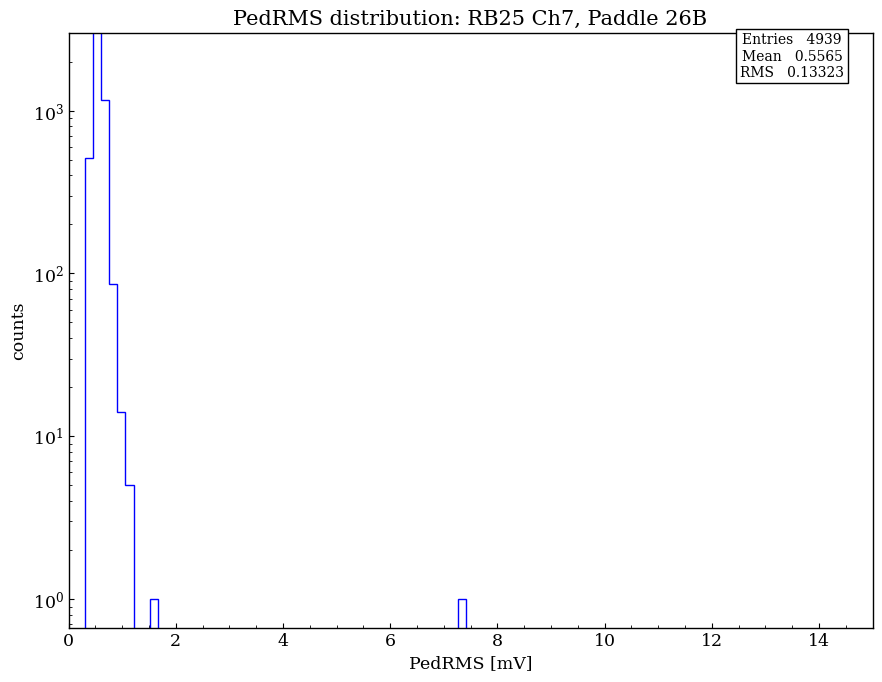

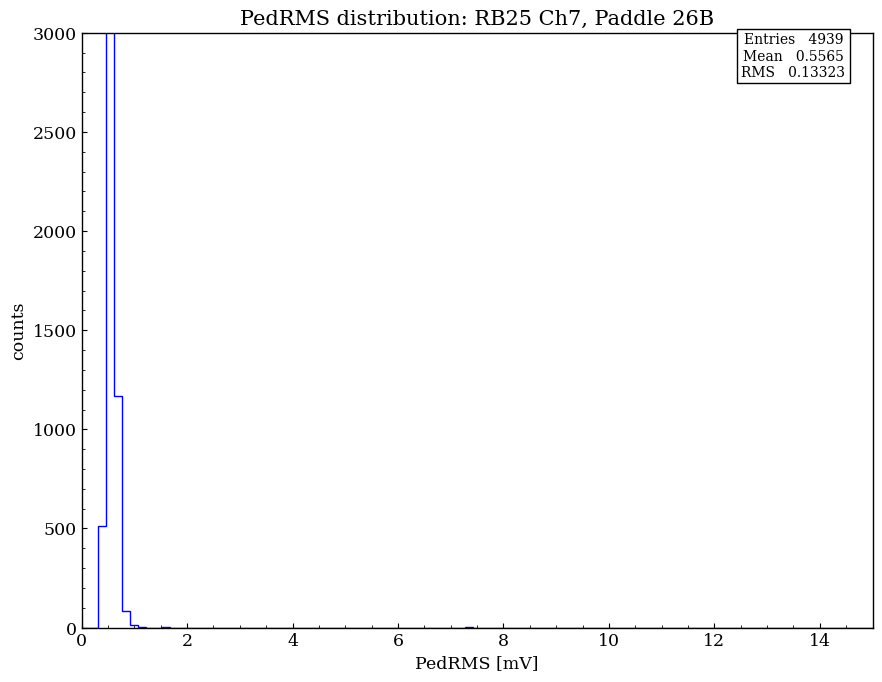

In [50]:
# choose rb, channel you want to plot PedRMS distribution for. ch is indexed at 0 (takes values 0 to 7)

rb = 25
ch = 6

pedRMS_list = np.array(pedrms_dict[rb][ch])
paddle_num = paddmap[str(rb)][str(ch+1)]%1000

if (paddmap[str(rb)][str(ch+1)] > 2000):
    paddle_AB = "B"
else:
    paddle_AB = "A"

# log scale
plotroot(pedRMS_list, 0, 15, "PedRMS [mV]", "counts", "PedRMS distribution: RB" + str(rb) + " Ch" + str(ch+1) + ", Paddle " + str(paddle_num) + paddle_AB, 3000, xlo=0, log=True)

# linear scale
plotroot(pedRMS_list, 0, 15, "PedRMS [mV]", "counts", "PedRMS distribution: RB" + str(rb) + " Ch" + str(ch+1) + ", Paddle " + str(paddle_num) + paddle_AB, 3000, xlo=0, log=False)



## Look at Q vs Q plots

visually inspect plots to look for dead channels, indicated by events xompletely clustered at an axis 

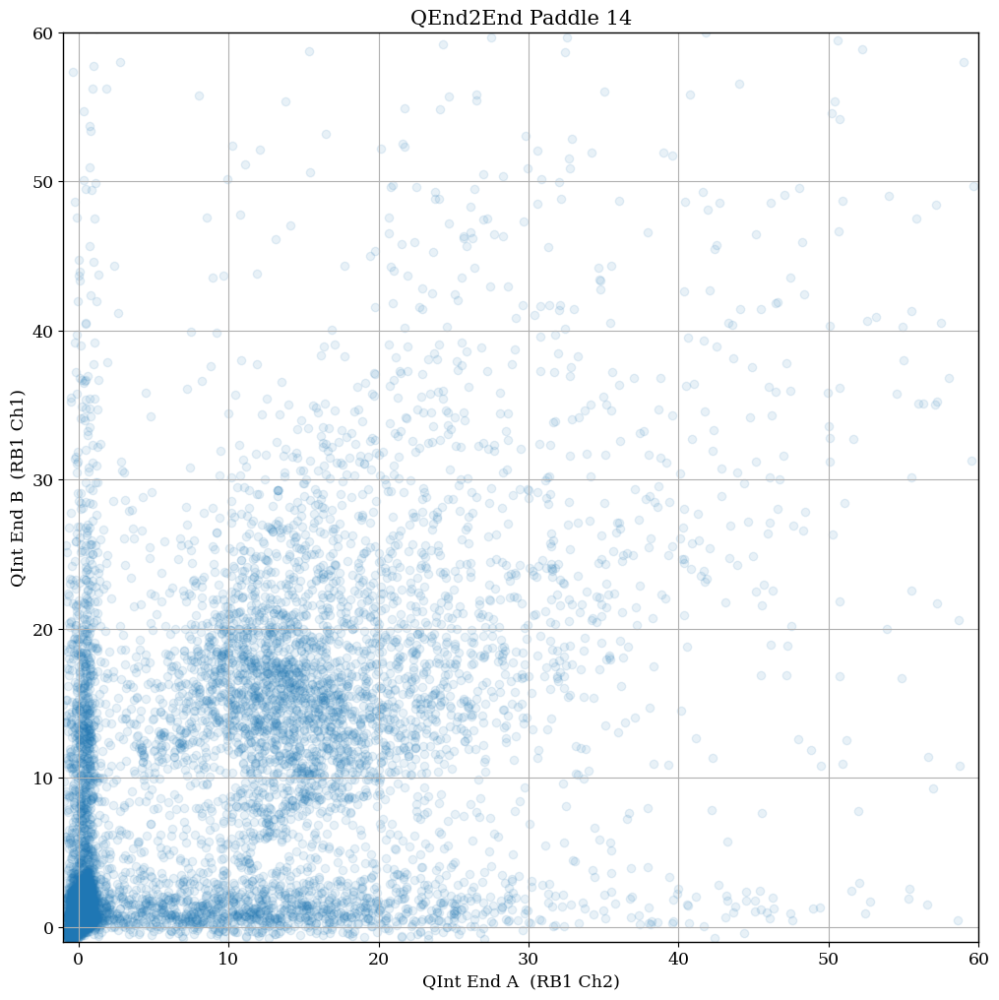

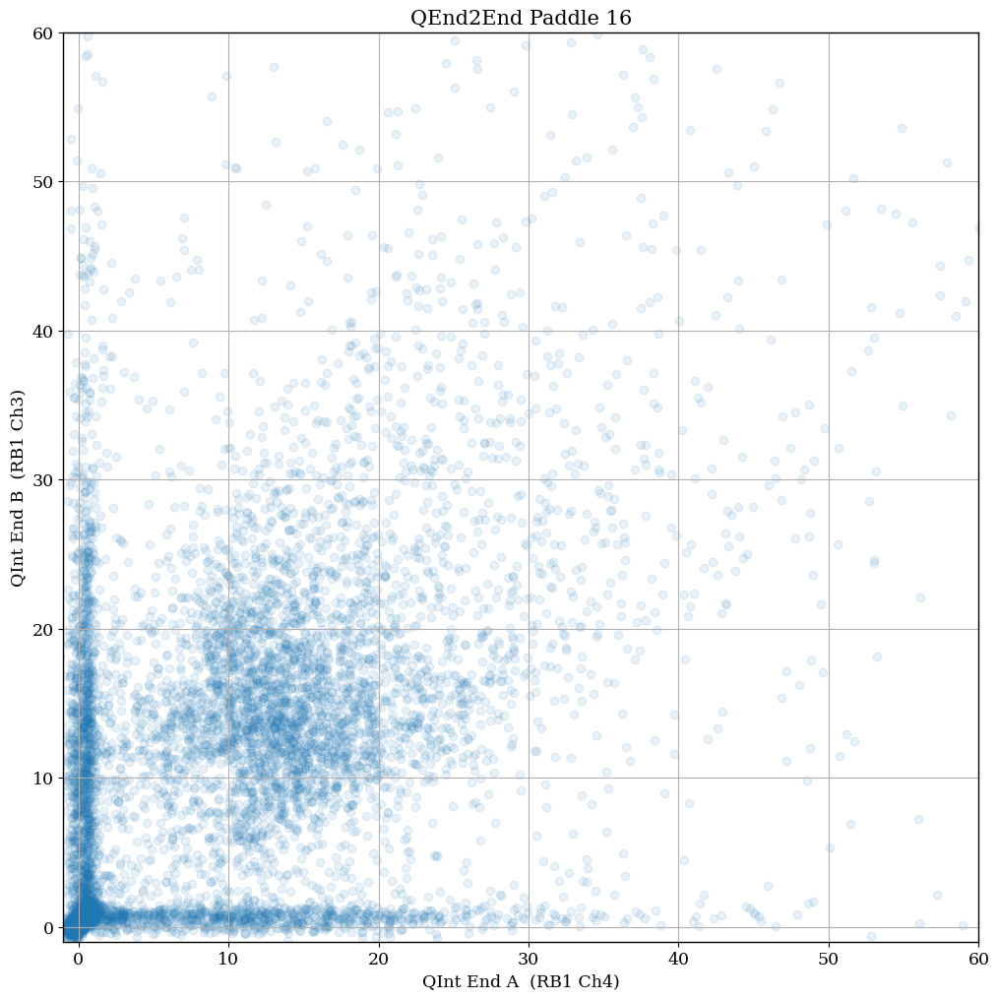

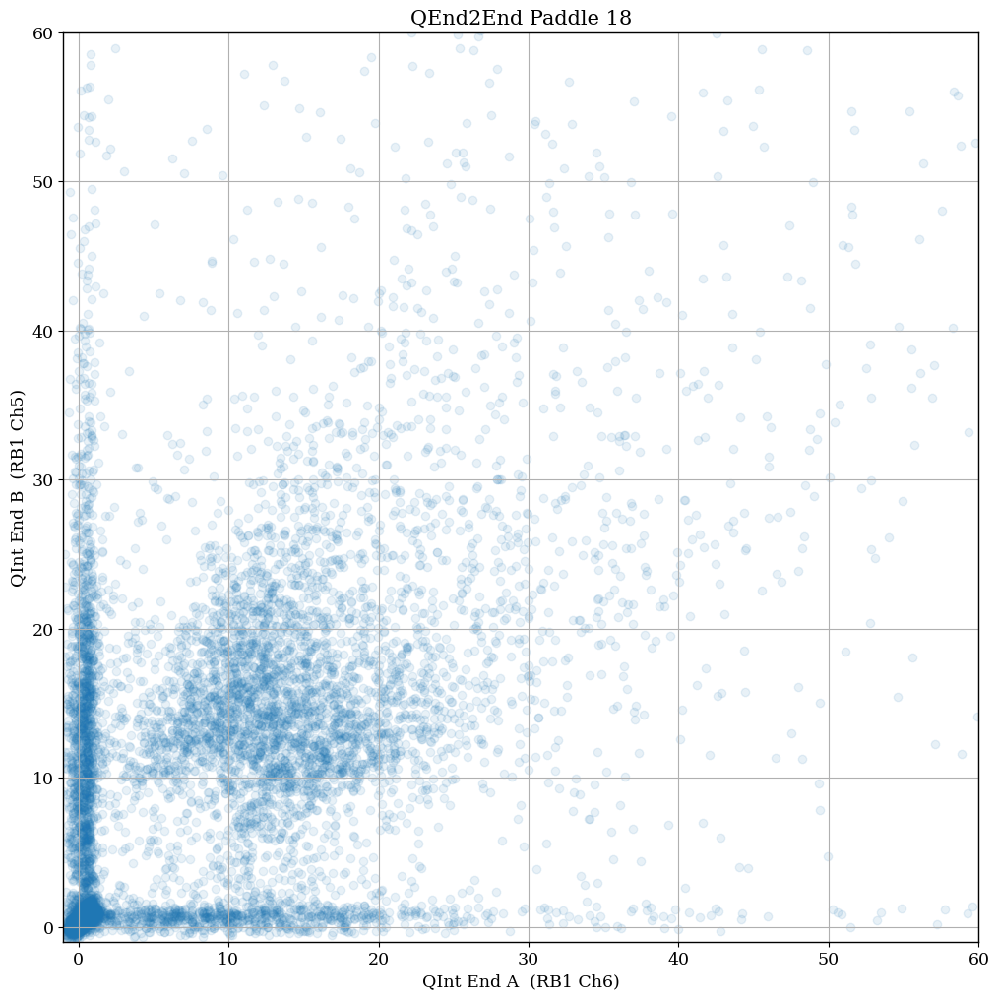

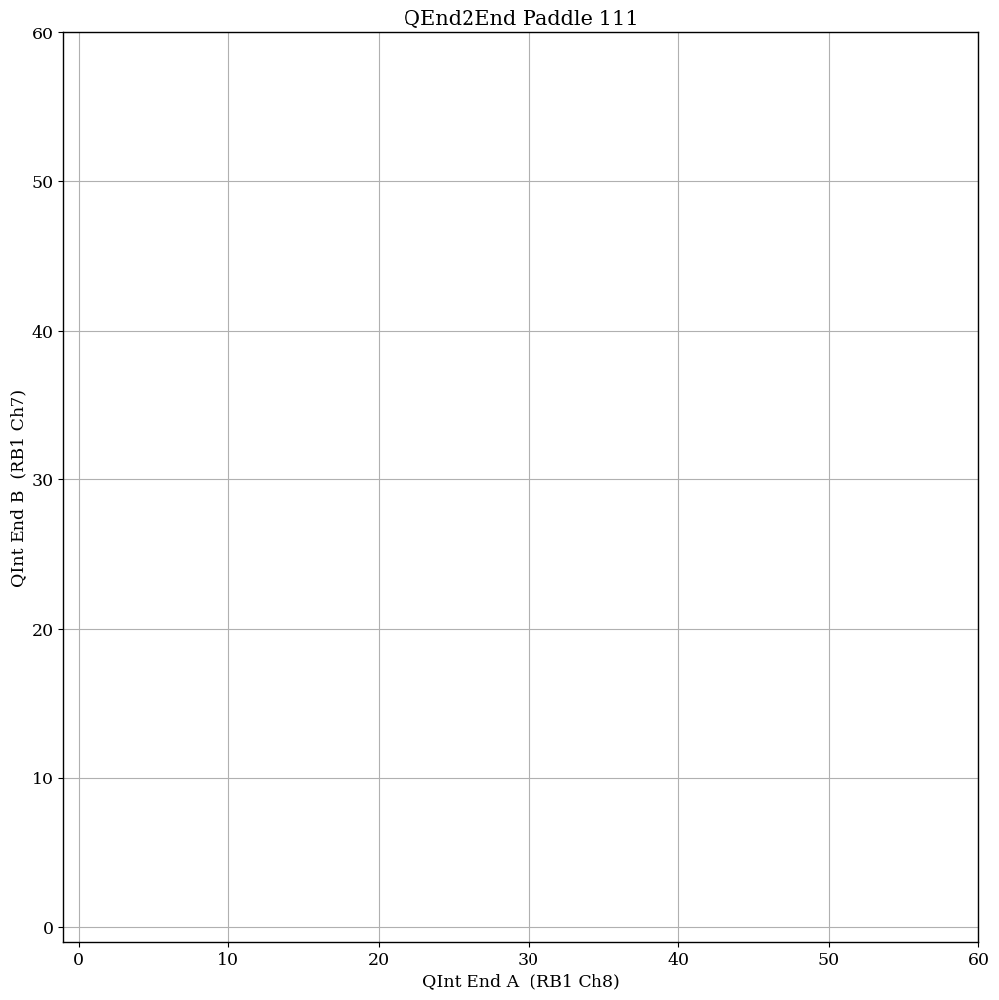

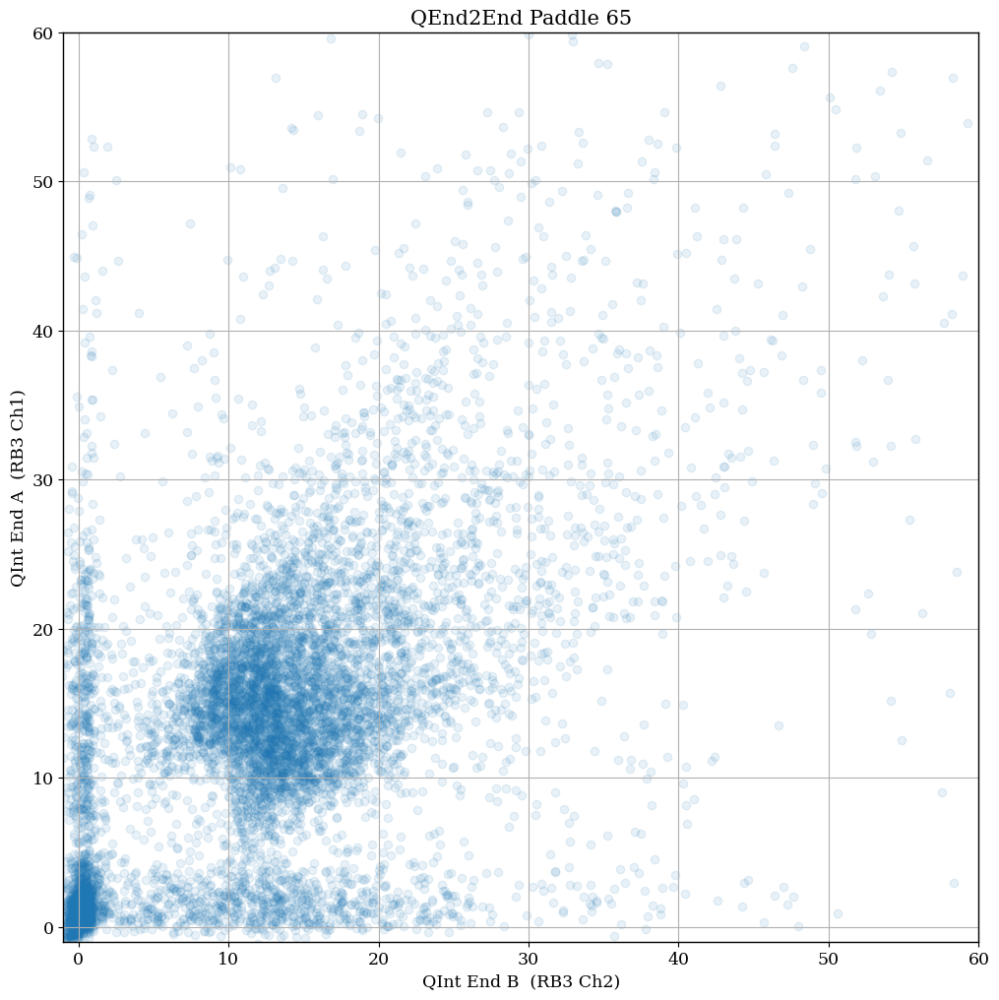

...

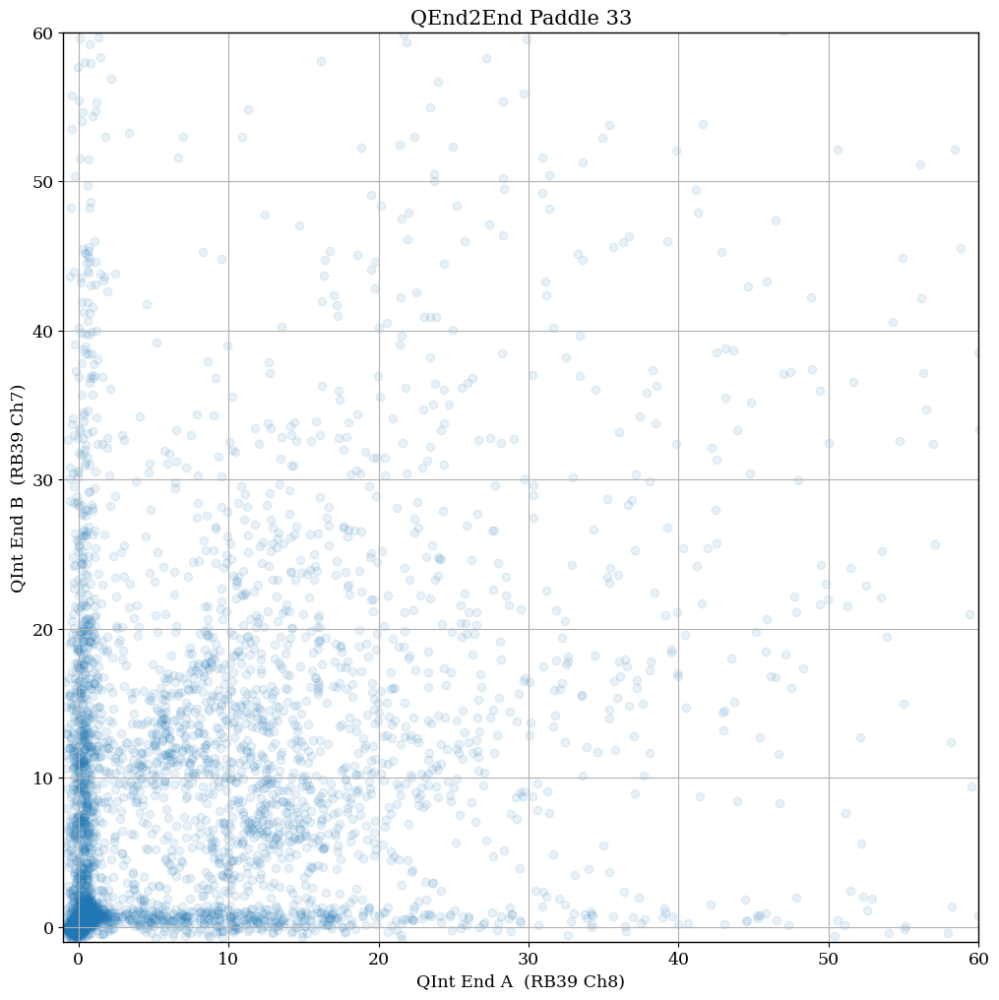

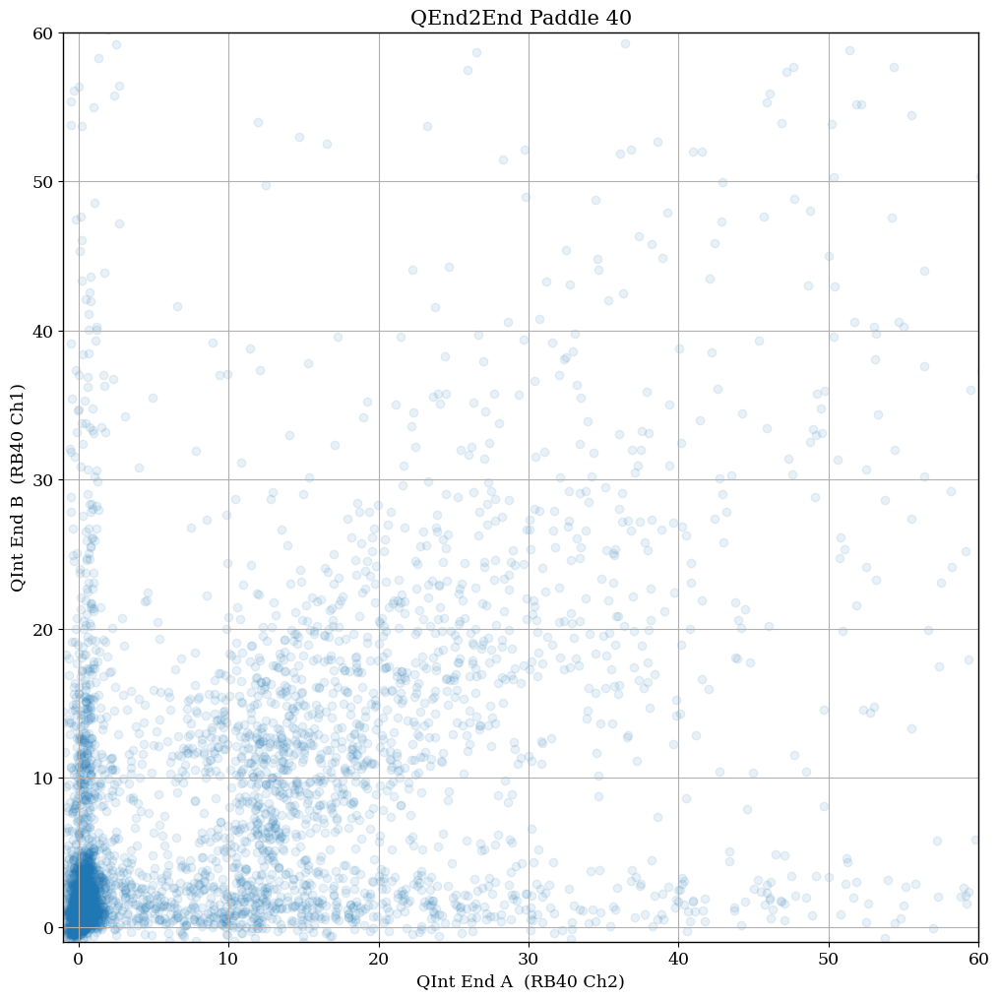

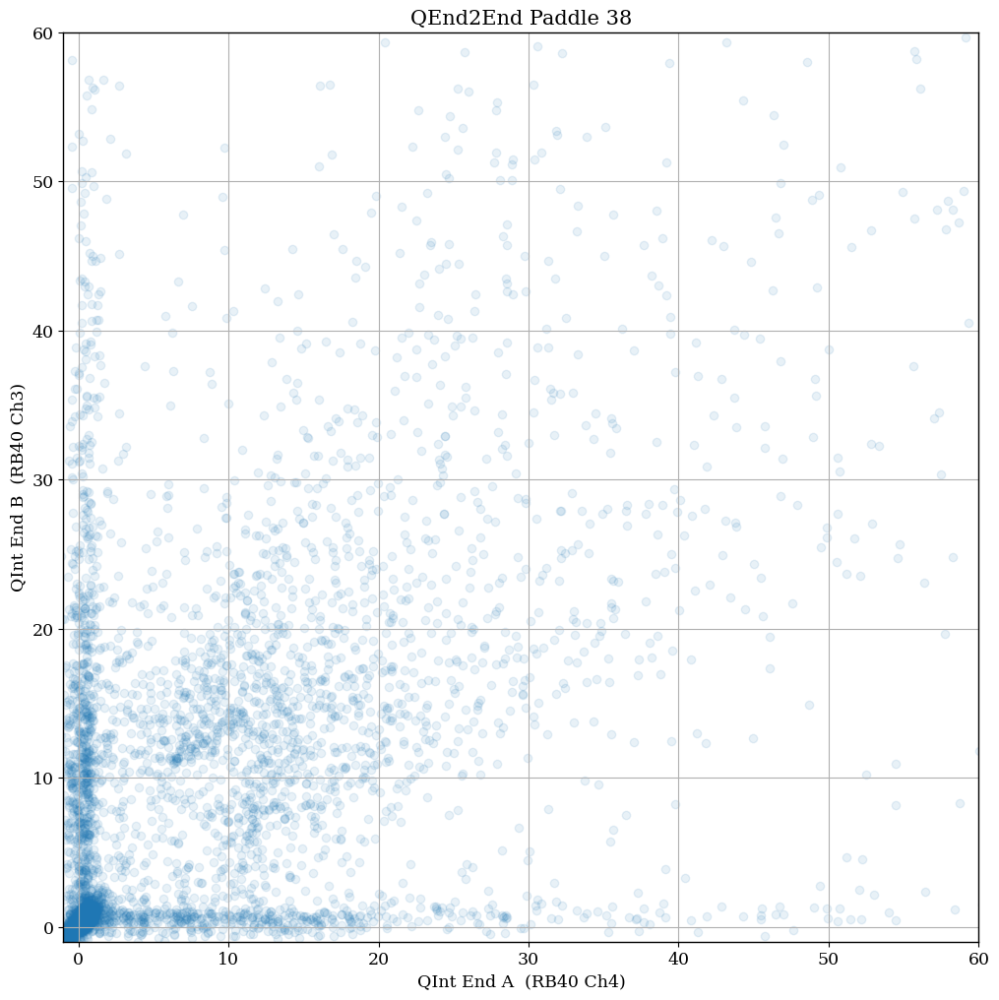

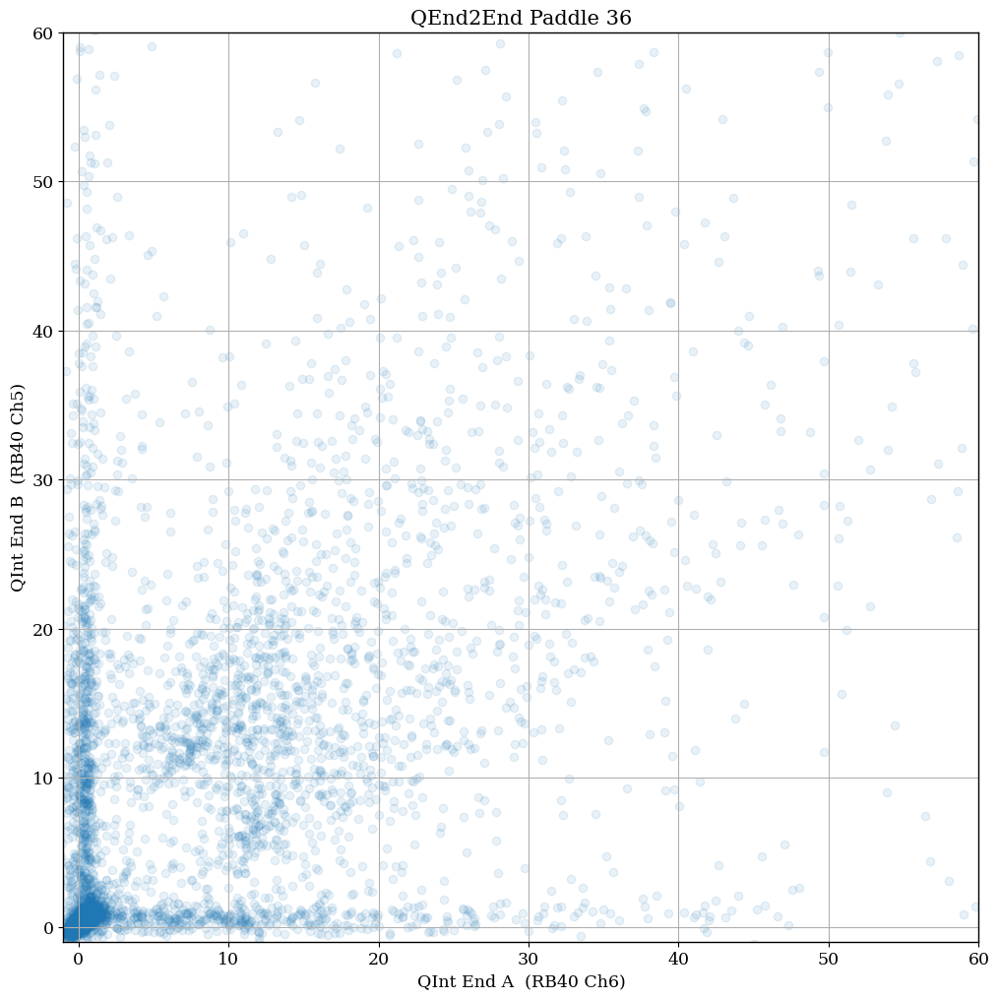

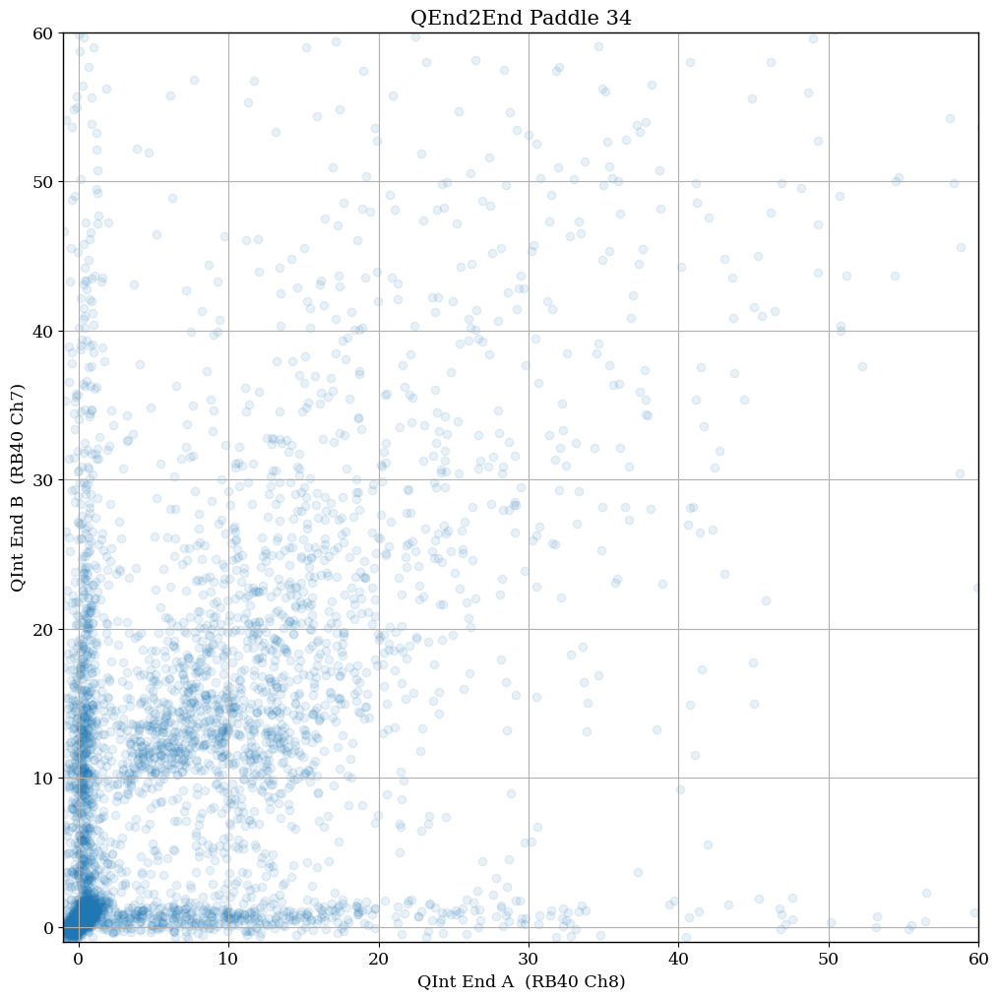

In [64]:
for rb in keys:

    for ch in range(4):
        
        padd1 = 2*(ch+1)
        padd2 = 2*(ch+1)-1
        
        paddle_num = paddmap[str(rb)][str(padd1)]%1000

        # umbrella paddle requirement
        #if (paddle_num > 60 and paddle_num < 109):

        # cube paddle requirement
        #if paddle_num < 61:

        # any paddle requirement
        if paddle_num > 0:
            
            if (paddmap[str(rb)][str(padd1)] > 2000):
                padd1_AB = "B"
                padd2_AB = "A"
                
                #if (paddmap[str(rb)][str(padd2)] > 2000):
                #    print("MISMATCH??")
            
            else:
                padd1_AB = "A"
                padd2_AB = "B"
                
                #if (paddmap[str(rb)][str(padd2)]  2000):
                #    print("MISMATCH??")
            
            fig,ax = plt.subplots(figsize=(12,12))

            padd2Q = np.array(Q_dict[rb][2*ch])
            padd1Q = np.array(Q_dict[rb][2*ch+1])
            plt.scatter(padd1Q,padd2Q,alpha=0.1)
            plt.ylim(-1,60)
            plt.xlim(-1,60)
            plt.xlabel("QInt End " + padd1_AB + "  (RB" + str(rb) + " Ch" + str(2*(ch+1)) + ")")
            plt.ylabel("QInt End " + padd2_AB + "  (RB" + str(rb) + " Ch" + str(2*(ch+1)-1) + ")")
            plt.grid()
            plt.title("QEnd2End Paddle " + str(paddle_num))
            plt.show()


# old approach (ignore)

## Create Ped, QInt Dicts

indexed by RBid, Ch

In [15]:
peds = []
pedrms = []

for key in keys:

    peds.append([[],[],[],[],[],[],[],[]])
    pedrms.append([[],[],[],[],[],[],[],[]])

ped_dict = dict(zip(keys, peds))
pedrms_dict = dict(zip(keys, pedrms))

In [16]:
pedrms_cut = []

for key in keys:

    pedrms_cut.append([0,0,0,0,0,0,0,0])

pedrmscut_dict = dict(zip(keys, pedrms_cut))

In [17]:
Qint = []

for key in keys:

    Qint.append([[],[],[],[],[],[],[],[]])

Q_dict = dict(zip(keys, Qint))

In [18]:
Qint_cut = []

for key in keys:

    Qint_cut.append([[],[],[],[],[],[],[],[]])

Qcut_dict = dict(zip(keys, Qint_cut))

In [19]:
Vmax = []

for key in keys:

    Vmax.append([[],[],[],[],[],[],[],[]])

V_dict = dict(zip(keys, Vmax))

## Calculate Ped avg, Ped RMS, and Qint for events in the run

In [12]:
for file in run:
    filepath = rundir + file
    reader = go.cxx_api.TofPacketReader(filepath)
    
    # rust api
    #reader = go.rust_api.io.TofPacketReader(filepath,filter=go.rust_api.io.PacketType.TofEvent)
    
    print (reader)
    packs = 0
    hold=0
    while packs < 35000:
        packs = packs+1
        packet = reader.get_next_tp()
        if packet.packet_type == go.cxx_api.PacketType.TofEvent:
            ev = packet.unpack()

    ## use with rust api
    #for pack in reader:
    #    ev = go.rust_api.events.TofEvent()
    #    ev.from_tofpacket(pack)
        
            for x in range(len(ev.rbevents)):
                
                if ev.rbevents[x].header.rb_id == 0:
                    print("RBID = ZERO!")
                    continue
                
                rbid = ev.rbevents[x].header.rb_id
                cal = cal_dict[rbid]
                pedlist = ped_dict[rbid]
                pedrmslist = pedrms_dict[rbid]
                Qlist = Q_dict[rbid]
                Qcutlist = Qcut_dict[rbid]
                Vlist = V_dict[rbid]
                
                for y in ev.rbevents[x].header.get_channels()[:-1]:
                    
                    chind1 = y+1
                    # find v,t for rbid,ch
                    volts = cal.voltages(ev.rbevents[x],chind1)
                    times = cal.nanoseconds(ev.rbevents[x],chind1)
                    # calculate ped, pedrms from ~350ns to ~450ns and add this to the proper pedlist, indexed starting at 0
                    ped = np.mean(volts[700:900])
                    pedlist[y].append(ped)
                    pedrmslist[y].append(np.std(volts[700:900]))
                    # find peak in a primitive way, from apprximately 10ns to 200ns
                    Vmax = np.max(volts[20:200])
                    Vlist[y].append(Vmax)
                    Vmax_ind = volts[20:200].argmax()
                    
                    # create integration window of 100 ns, 20ns before and 80ns after peak (or shifted to not include first 10 bins)
                    if Vmax_ind < 50:
                        startInt = 10
                        stopInt = 210
                    else:
                        startInt = Vmax_ind - 40
                        stopInt = Vmax_ind + 160
                        
                    ## print one value per fle to check
                    #if hold == 0:
                    #    print(np.trapz(volts[startInt:stopInt]-ped,x=times[startInt:stopInt])/50)
                    #    hold = 1

                    # integrate and append the Q list adn Qcut list, indexed starting at 0
                    Qlist[y].append((np.trapz(volts[startInt:stopInt]-ped,x=times[startInt:stopInt]))/50)
                    if ((np.trapz(volts[startInt:stopInt]-ped,x=times[startInt:stopInt]))/50 > 4.0):
                        Qcutlist[y].append((np.trapz(volts[startInt:stopInt]-ped,x=times[startInt:stopInt]))/50)
                    
                    
                # update ped, pedrms, Q dictionaries for this rb
                ped_dict.update({rbid: pedlist})
                pedrms_dict.update({rbid: pedrmslist})
                Q_dict.update({rbid: Qlist})
                Qcut_dict.update({rbid: Qcutlist})
                V_dict.update({rbid: Vlist})
                    

[2024-06-04 12:42:10.886] [info] [io.cxx:180] Will read packets from /home/gaps/csbf-data/11/Run11_0.240527_175427+0000.tof.gaps [420.00 MB]
<TofPacketReader : /home/gaps/csbf-data/11/Run11_0.240527_175427+0000.tof.gaps - read 0 TofPackets>
<TofPacketReader : /home/gaps/csbf-data/11/Run11_1.240527_175616+0000.tof.gaps - read 0 TofPackets>
[info] [io.cxx - set_filename:180] [2024-06-04 12:42:19] -- Will read packets from /home/gaps/csbf-data/11/Run11_1.240527_175616+0000.tof.gaps [420.01 MB]
<TofPacketReader : /home/gaps/csbf-data/11/Run11_2.240527_175753+0000.tof.gaps - read 0 TofPackets>
[info] [io.cxx - set_filename:180] [2024-06-04 12:42:27] -- Will read packets from /home/gaps/csbf-data/11/Run11_2.240527_175753+0000.tof.gaps [420.00 MB]
<TofPacketReader : /home/gaps/csbf-data/11/Run11_3.240527_175932+0000.tof.gaps - read 0 TofPackets>
[info] [io.cxx - set_filename:180] [2024-06-04 12:42:36] -- Will read packets from /home/gaps/csbf-data/11/Run11_3.240527_175932+0000.tof.gaps [420.0

RuntimeError: No more packets in file!

## Look at Number of Events Received + Pedestal distributions

the code below prints statistics for PedRMS for all paddles in the umbrella. 

- if no events are found, a warning is printed. 
- if a high avg RMS is found (> 0.7), a warning is printed and the distribution of PedRMS for the events on this channel are plotted

  plt.ylim(0,ylim)




Readout Board 3
  channel 1 : Paddle 65A
    events = 5279
    mean   = 0.580
    RMS    = 0.127

  channel 2 : Paddle 65B
    events = 5279
    mean   = 0.536
    RMS    = 0.079

  channel 3 : Paddle 63A
    events = 4965
    mean   = 0.523
    RMS    = 0.071

  channel 4 : Paddle 63B
    events = 4965
    mean   = 0.511
    RMS    = 0.067

  channel 5 : Paddle 61A
    events = 5234
    mean   = 0.541
    RMS    = 0.071

  channel 6 : Paddle 61B
    events = 5234
    mean   = 0.525
    RMS    = 0.067

  channel 7 : Paddle 73A
    events = 5433
    mean   = 0.536
    RMS    = 0.065

  channel 8 : Paddle 73B
    events = 5433
    mean   = 0.562
    RMS    = 0.075


Readout Board 13
  channel 1 : Paddle 93A
    events = 5348
    mean   = 0.571
    RMS    = 0.121

  channel 2 : Paddle 93B
    events = 5348
    mean   = 0.523
    RMS    = 0.079

  channel 3 : Paddle 95A
    events = 4733
    mean   = 0.540
    RMS    = 0.082

  channel 4 : Paddle 95B
    events = 4733
    mean   = 0.548
 

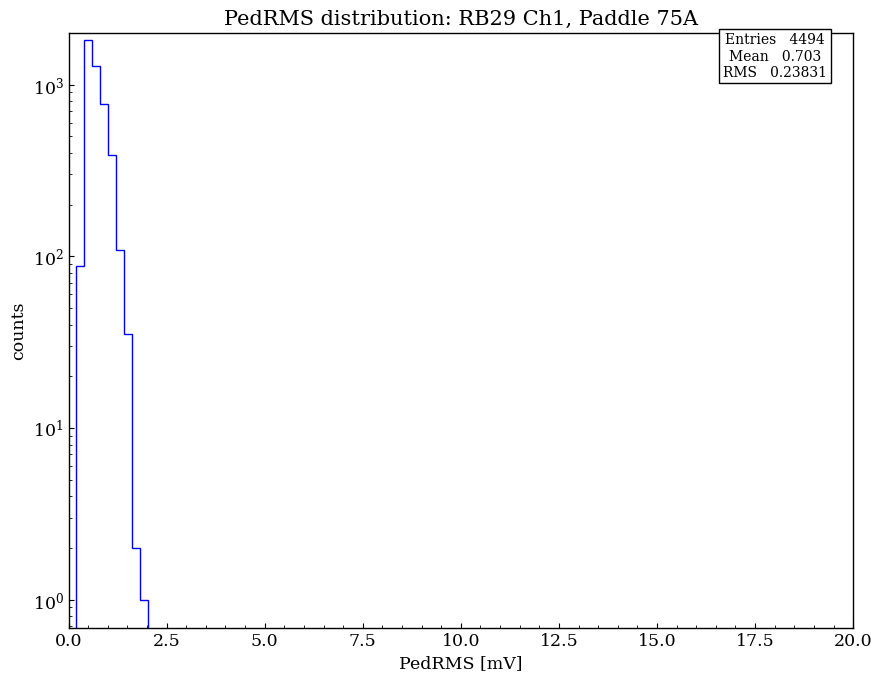

  channel 2 : Paddle 75B
    events = 4494
    mean   = 0.587
    RMS    = 0.158

  channel 3 : Paddle 77A
    events = 4814
    mean   = 0.578
    RMS    = 0.159

  channel 4 : Paddle 77B
    events = 4814
    mean   = 0.578
    RMS    = 0.157

  channel 5 : Paddle 107A
    events = 5409
    mean   = 0.593
    RMS    = 0.159

  channel 6 : Paddle 107B
    events = 5409
    mean   = 0.594
    RMS    = 0.157

  channel 7 : Paddle 105A
    events = 3508
    mean   = 0.626
    RMS    = 0.140

  channel 8 : Paddle 105B
    events = 3508
    mean   = 0.650
    RMS    = 0.140


Readout Board 31
  channel 1 : Paddle 76A
    events = 5400
    mean   = 0.576
    RMS    = 0.124

  channel 2 : Paddle 76B
    events = 5400
    mean   = 0.546
    RMS    = 0.090

  channel 3 : Paddle 78A
    events = 4967
    mean   = 0.533
    RMS    = 0.085

  channel 4 : Paddle 78B
    events = 4967
    mean   = 0.528
    RMS    = 0.079

  channel 5 : Paddle 108A
    events = 4011
    mean   = 0.551
    RMS    = 

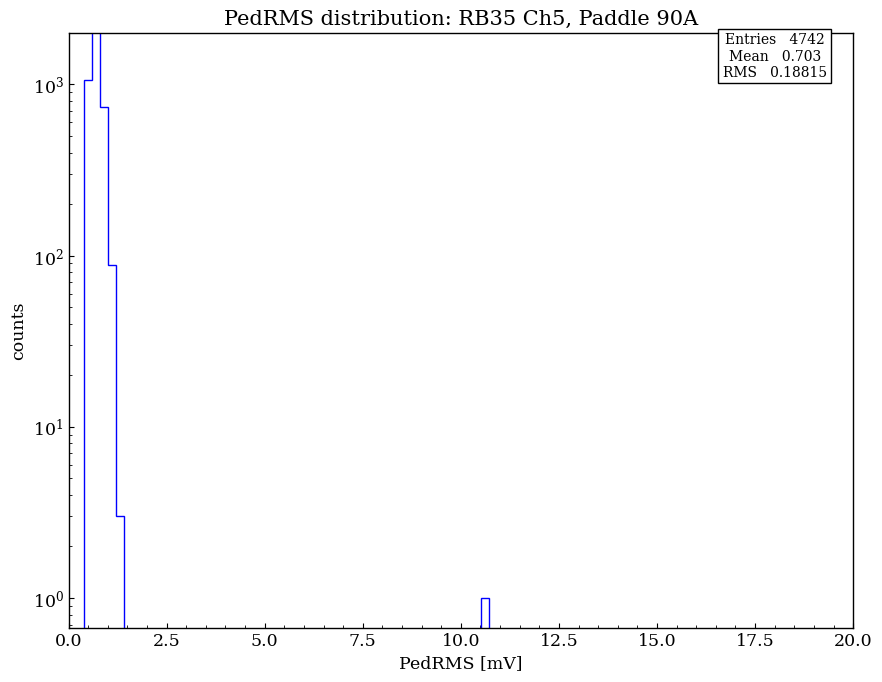

  channel 6 : Paddle 90B
    events = 4742
    mean   = 0.710
    RMS    = 0.195



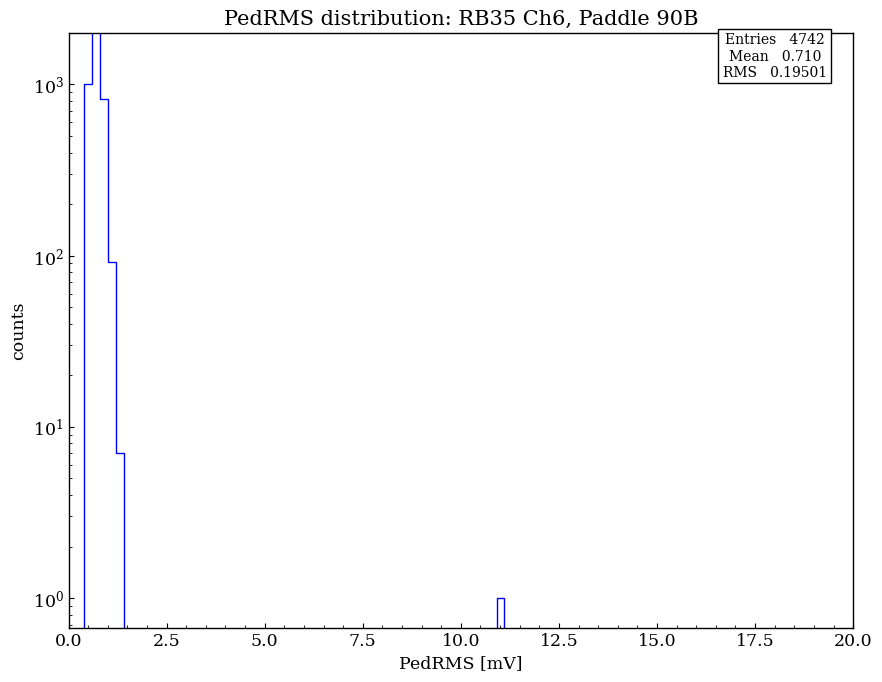

  channel 7 : Paddle 88A
    events = 4590
    mean   = 0.557
    RMS    = 0.074

  channel 8 : Paddle 88B
    events = 4590
    mean   = 0.572
    RMS    = 0.075



In [13]:
for rb in keys:
    print("\nReadout Board " + str(rb))
    for ch in range(0,8):
        
        pedRMS_list = np.array(pedrms_dict[rb][ch])
        paddle_num = paddmap[str(rb)][str(ch+1)]%1000

        # uncomment to choose paddle requirement
        
        # umbrella paddle requirement
        if (paddle_num > 60 and paddle_num < 109):

        # cube paddle requirement
        #if (paddle_num < 57):

        # cube paddle requirement with corners
        #if (paddle_num < 61):

        # full TOF, not real requirement but just easier to format code
        #if (paddle_num > 0):
            
            if (paddmap[str(rb)][str(ch+1)] > 2000):
                paddle_AB = "B"
            else:
                paddle_AB = "A"

            print("  channel " + str(ch+1) + " : Paddle " + str(paddle_num) + paddle_AB)
            if len(pedRMS_list) == 0:
                print("        ! ! ! ! NO EVENTS FOR THIS CHANNEL ! ! ! !")
            print("    events = {0:d}\n".format(len(pedRMS_list)) + "    mean   = {0:.3f}\n".format(np.mean(pedRMS_list)) + "    RMS    = {0:.3f}\n".format(np.std(pedRMS_list-np.mean(pedRMS_list))))

            if (np.mean(pedRMS_list) > 0.7):
                print("        ! ! ! ! HIGH PedRMS ! ! ! !")
                plotroot(pedRMS_list, 0, 20, "PedRMS [mV]", "counts", "PedRMS distribution: RB" + str(rb) + " Ch" + str(ch+1) + ", Paddle " + str(paddle_num) + paddle_AB, 2000, xlo=0, log=True)



the code below prints statistics for Pedestal values for all paddles in the umbrella. also, information about the truncated distribution is printed, including number of outliers.

- if a high RMS is found (> 0.7), a warning is printed
- if many outliers are found (> 2%), a warning is printed

In [20]:
for rb in keys:
    print("\nReadout Board " + str(rb))
    for ch in range(8):
        
        paddle_num = paddmap[str(rb)][str(ch+1)]%1000

        # umbrella paddle requirement
        if (paddle_num > 60 and paddle_num < 109):
            
            if (paddmap[str(rb)][str(ch+1)] > 2000):
                paddle_AB = "B"
            else:
                paddle_AB = "A"

            ped_list = np.array(ped_dict[rb][ch])
            ped_sigma = np.std(ped_list)
            ped_mean = np.mean(ped_list)
        
            trunc1_ped = ped_list[ped_list < ped_mean+4*ped_sigma]
            trunc_ped = trunc1_ped[trunc1_ped > ped_mean-4*ped_sigma]
        
            print("  channel " + str(ch+1) + " : Paddle " + str(paddle_num) + paddle_AB)
            if (np.mean(ped_sigma) > 0.7):
                print("        ! ! ! ! HIGH RMS ! ! ! !")
            print("    PED mean, RMS       = " + str(ped_mean) +", "+ str(ped_sigma))
            print("    truncated mean, RMS = " + str(np.mean(trunc_ped)) +", "+ str(np.std(trunc_ped)))
            if ((len(ped_list)-len(trunc_ped))/len(ped_list) > 0.02):
                print("        ! ! ! ! MANY OUTLIERS ! ! ! !")
            print("    outliers            = "+ str(len(ped_list)-len(trunc_ped)))
    


Readout Board 3
  channel 1 : Paddle 65A
    PED mean, RMS       = 0.06687811, 0.38916582
    truncated mean, RMS = 0.05890712, 0.36956722
    outliers            = 22
  channel 2 : Paddle 65B
    PED mean, RMS       = -0.12877657, 0.3166024
    truncated mean, RMS = -0.13967264, 0.26482332
    outliers            = 48
  channel 3 : Paddle 63A
    PED mean, RMS       = 0.53437555, 0.31714034
    truncated mean, RMS = 0.52137977, 0.25908443
    outliers            = 51
  channel 4 : Paddle 63B
    PED mean, RMS       = 0.44405127, 0.30525008
    truncated mean, RMS = 0.4291554, 0.25344747
    outliers            = 51
  channel 5 : Paddle 61A
    PED mean, RMS       = 0.973978, 0.33828107
    truncated mean, RMS = 0.96670234, 0.27371836
    outliers            = 59
  channel 6 : Paddle 61B
    PED mean, RMS       = 0.90157086, 0.33592424
    truncated mean, RMS = 0.8930607, 0.2700565
    outliers            = 51
  channel 7 : Paddle 73A
    PED mean, RMS       = 1.3850662, 0.36205256
  

## Look at Integrated Charge distributions

the code below shows statistics for QInt distributions for each umbrella paddle end (truncated at 5 pC)
- a warning is printed, and distributions for both paddle ends are plotted, if the average value at either paddle is calculated to be less than 14 pC

*these distributions are NOT gaussian*

  plt.ylim(0,ylim)




Readout Board 3
  channel 1 : Paddle 65B
    Qint mean, RMS         = 18.277306540526734, 12.12602178572244
    # of events > 5pC      = 4014
    Qint mean, RMS          = 17.672736131582084, 12.639222013282899
    # of events > 5pC       = 4147
  channel 0 : Paddle 65A
  channel 3 : Paddle 63B
    Qint mean, RMS         = 17.12418562753375, 14.321514993299482
    # of events > 5pC      = 4230
    Qint mean, RMS          = 16.192605864760008, 11.976406521289796
    # of events > 5pC       = 4035
  channel 2 : Paddle 63A
  channel 5 : Paddle 61B
    Qint mean, RMS         = 20.10187905960837, 16.976066265494488
    # of events > 5pC      = 4555
    Qint mean, RMS          = 17.10839269336711, 16.127206168446847
    # of events > 5pC       = 4228
  channel 4 : Paddle 61A
  channel 7 : Paddle 73B
    Qint mean, RMS         = 19.93549139989744, 18.838852529478835
    # of events > 5pC      = 4681
    Qint mean, RMS          = 21.739660226854518, 22.876151760491712
    # of events > 5pC   

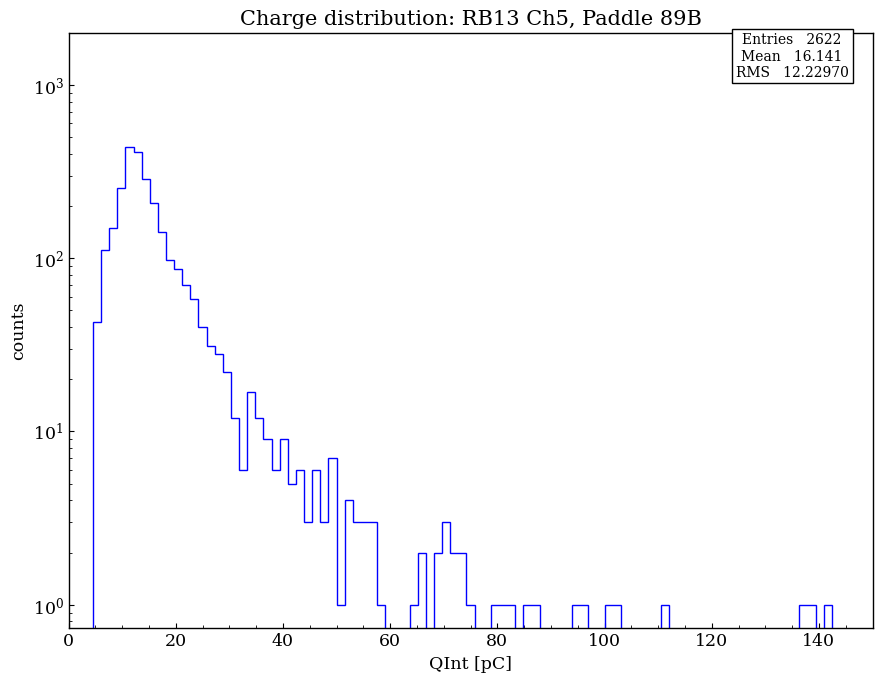

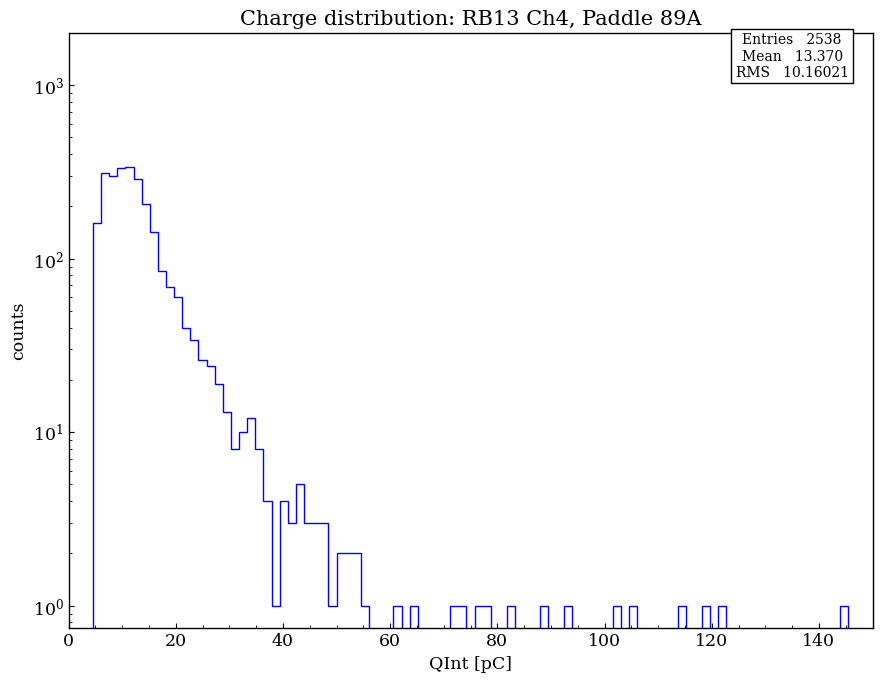

  channel 7 : Paddle 87B
    Qint mean, RMS         = 18.337744669182957, 13.287021366180566
    # of events > 5pC      = 4134
    Qint mean, RMS          = 15.28181386795044, 11.378283909210992
    # of events > 5pC       = 4000
  channel 6 : Paddle 87A

Readout Board 14
  channel 1 : Paddle 67A
    Qint mean, RMS         = 18.996200933666714, 14.695731169313506
    # of events > 5pC      = 4671
    Qint mean, RMS          = 18.58460902599952, 14.100429985319842
    # of events > 5pC       = 4777
  channel 0 : Paddle 67B
  channel 3 : Paddle 69A
    Qint mean, RMS         = 16.380319839519842, 10.851232698243887
    # of events > 5pC      = 4328
    Qint mean, RMS          = 17.703877133456146, 12.322692185435612
    # of events > 5pC       = 4202
  channel 2 : Paddle 69B
  channel 5 : Paddle 71A
    Qint mean, RMS         = 17.58328748511053, 15.506261028867407
    # of events > 5pC      = 4710
    Qint mean, RMS          = 17.587449504845566, 17.022920769397203
    # of events > 5pC

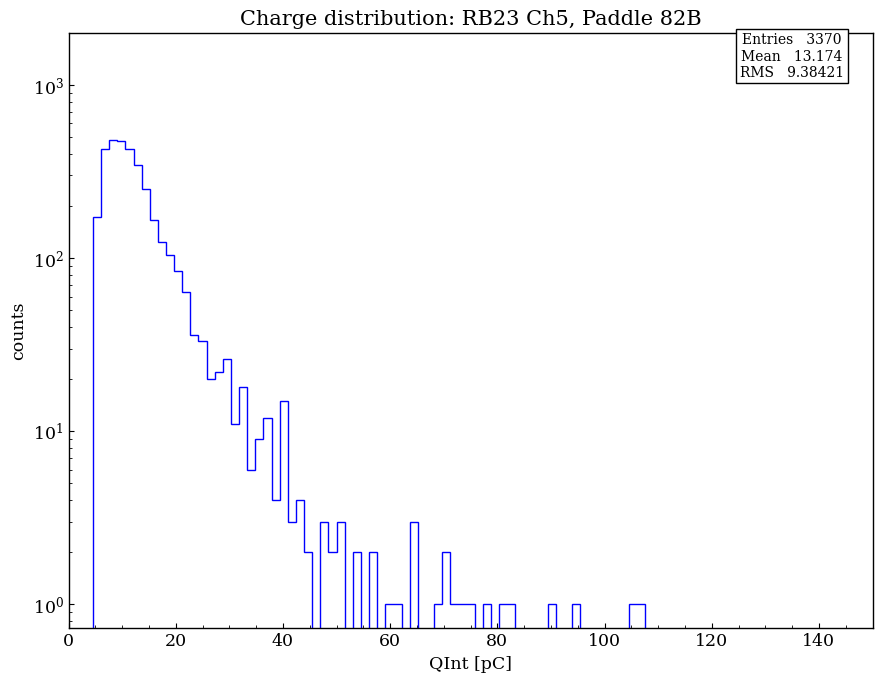

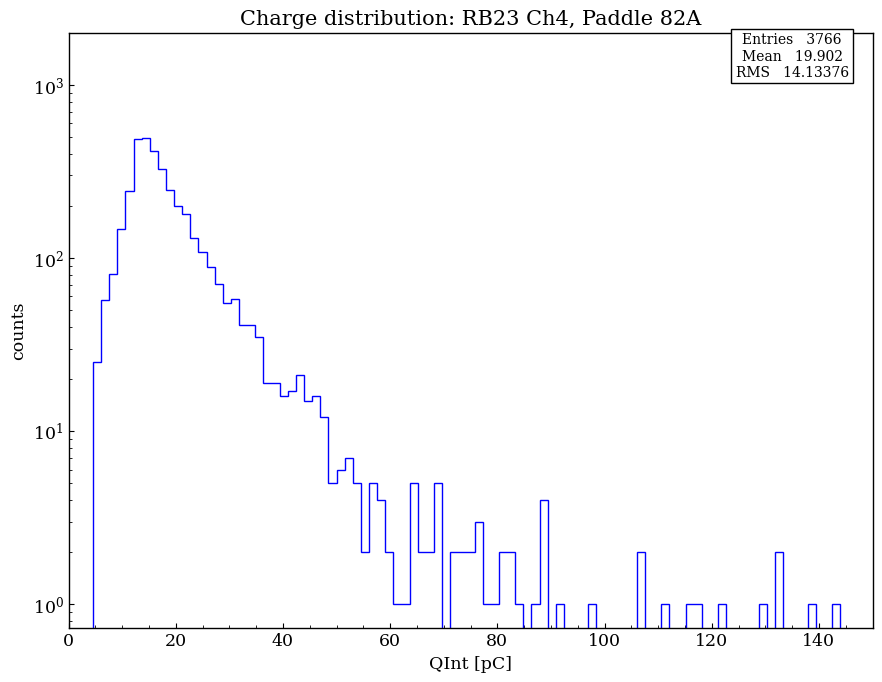

  channel 7 : Paddle 80B
    Qint mean, RMS         = 20.21020746568654, 17.056202960887298
    # of events > 5pC      = 3650
    Qint mean, RMS          = 19.41284928159424, 16.384457182725495
    # of events > 5pC       = 3529
  channel 6 : Paddle 80A

Readout Board 24
  channel 1 : Paddle 104B
    Qint mean, RMS         = 19.955170153967828, 15.10514122414218
    # of events > 5pC      = 5213
    Qint mean, RMS          = 17.420895908673604, 14.35493382233096
    # of events > 5pC       = 5184
  channel 0 : Paddle 104A
  channel 3 : Paddle 101B
    Qint mean, RMS         = 19.04964032541658, 15.359830140402638
    # of events > 5pC      = 4824
    Qint mean, RMS          = 17.605871064375066, 13.810586964644203
    # of events > 5pC       = 4754
  channel 2 : Paddle 101A
  channel 5 : Paddle 99B
    Qint mean, RMS         = 17.88979312263235, 13.731811830731472
    # of events > 5pC      = 4998
    Qint mean, RMS          = 15.802181161990838, 12.946810064871423
    # of events > 5p

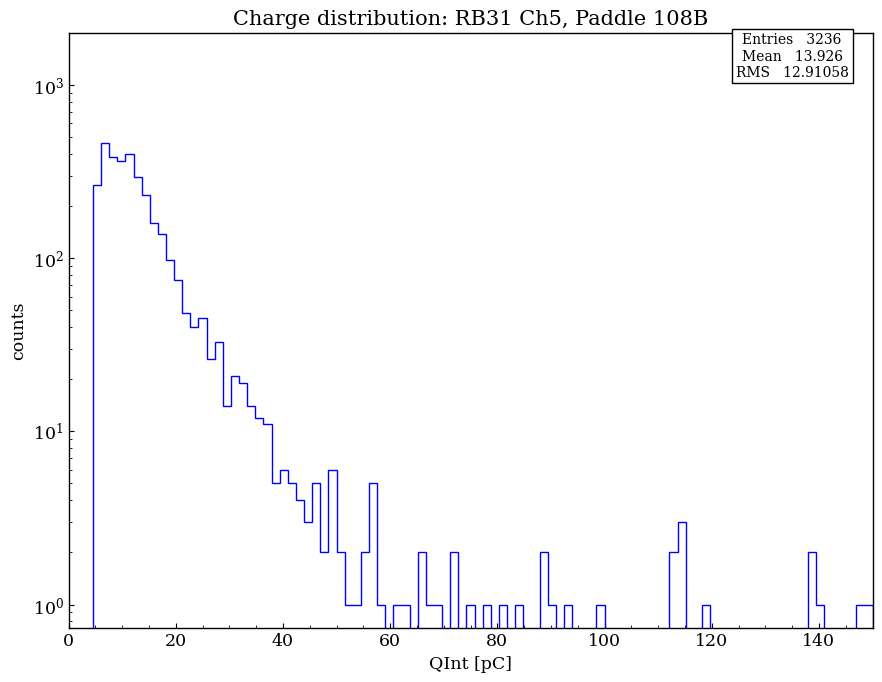

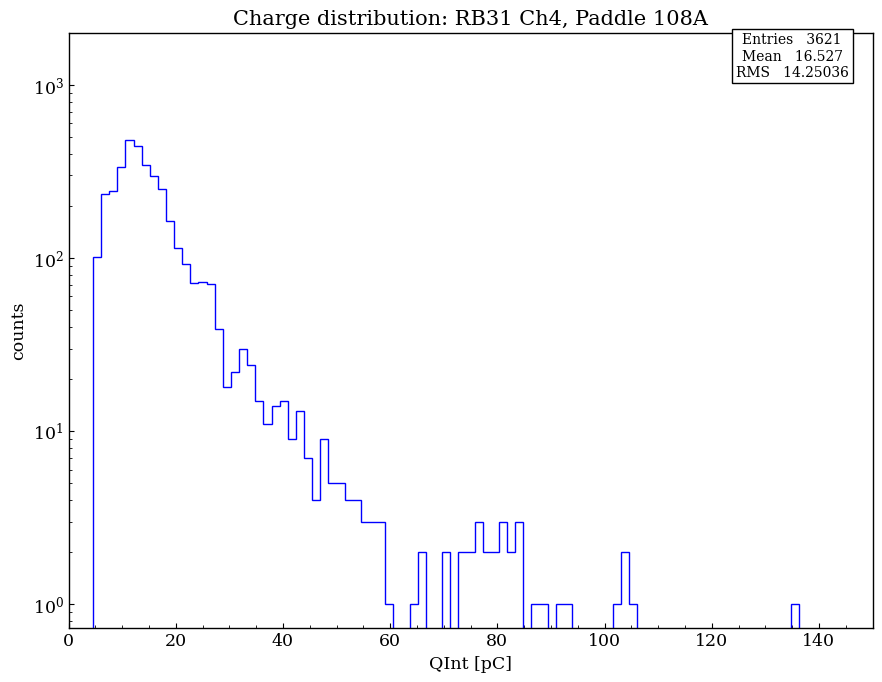

  channel 7 : Paddle 106B
    Qint mean, RMS         = 14.334927176409733, 11.198231328547793
    # of events > 5pC      = 3218
    Qint mean, RMS          = 16.21519124195067, 12.990085558628564
    # of events > 5pC       = 3239
  channel 6 : Paddle 106A

Readout Board 32
  channel 1 : Paddle 68A
    Qint mean, RMS         = 18.73886495439989, 16.497715532485035
    # of events > 5pC      = 4609
    Qint mean, RMS          = 18.10446318321892, 17.726720909426188
    # of events > 5pC       = 4657
  channel 0 : Paddle 68B
  channel 3 : Paddle 70A
    Qint mean, RMS         = 14.871968984930234, 11.884739342873763
    # of events > 5pC      = 4208
    Qint mean, RMS          = 15.643142263276571, 12.519707702574626
    # of events > 5pC       = 4070
  channel 2 : Paddle 70B
  channel 5 : Paddle 72A
    Qint mean, RMS         = 19.220493459464205, 15.109716498424167
    # of events > 5pC      = 4621
    Qint mean, RMS          = 17.95718707577921, 13.757045428758367
    # of events > 5p

In [33]:
for rb in keys:
    print("\nReadout Board " + str(rb))

    for ch in range(4):
        
        padd1 = 2*(ch+1)
        padd2 = 2*(ch+1)-1
        
        paddle_num = paddmap[str(rb)][str(padd1)]%1000

        # umbrella paddle requirement
        if (paddle_num > 60 and paddle_num < 109):
            
            if (paddmap[str(rb)][str(padd1)] > 2000):
                padd1_AB = "B"
                padd2_AB = "A"
                
                #if (paddmap[str(rb)][str(padd2)] > 2000):
                #    print("MISMATCH??")
            
            else:
                padd1_AB = "A"
                padd2_AB = "B"
                
                #if (paddmap[str(rb)][str(padd2)]  2000):
                #    print("MISMATCH??")

            padd2Q = np.array(Qcut_dict[rb][2*ch])
            padd1Q = np.array(Qcut_dict[rb][2*ch+1])

            plot=0
            
            print("  channel " + str(2*ch+1) + " : Paddle " + str(paddle_num) + padd1_AB)

            if (np.mean(padd2Q) < 14):
                print("        ! ! ! ! LOW AVG CHARGE ! ! ! !")
                plot=1
            print("    Qint mean, RMS         = " + str(np.mean(padd2Q)) +", "+ str(np.std(padd2Q)))
            print("    # of events > 5pC      = " + str(len(padd2Q)))
            
            if (np.mean(padd1Q) < 14):
                print("        ! ! ! ! LOW AVG CHARGE ! ! ! !")
                plot=1
            print("    Qint mean, RMS          = " + str(np.mean(padd1Q)) +", "+ str(np.std(padd1Q)))
            print("    # of events > 5pC       = " + str(len(padd1Q)))

            print("  channel " + str(2*ch) + " : Paddle " + str(paddle_num) + padd2_AB)
            
            if plot==1:
                plotroot(padd1Q, 0, 150, "QInt [pC]", "counts", "Charge distribution: RB" + str(rb) + " Ch" + str(2*ch+1) + ", Paddle " + str(paddle_num) + padd1_AB, 2000, xlo=0, log=True)
                plotroot(padd2Q, 0, 150, "QInt [pC]", "counts", "Charge distribution: RB" + str(rb) + " Ch" + str(2*ch) + ", Paddle " + str(paddle_num)+ padd2_AB, 2000, xlo=0, log=True)




## Look at Q vs Q plot

the code below plots QEnd2End for each umbrella paddle. *requires visually inspecting for dead channels by searching for plots hugging either axis or the origin*


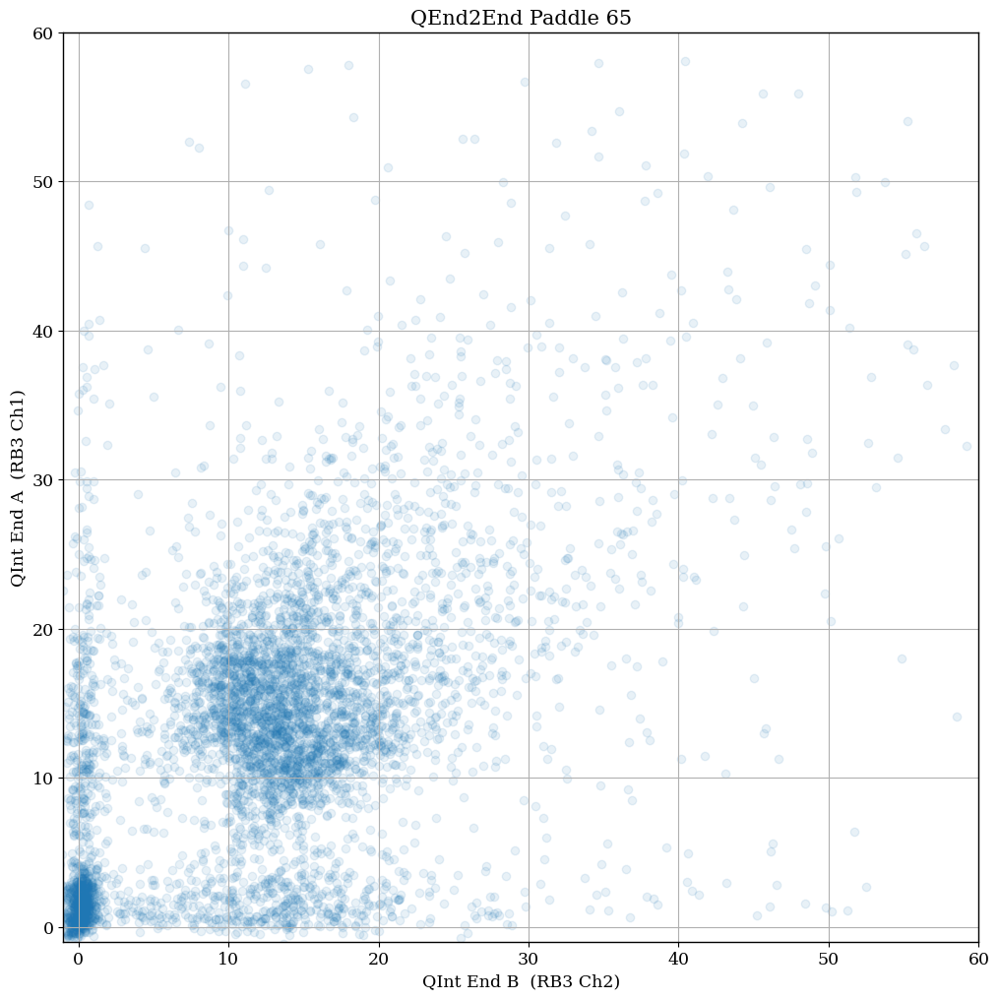

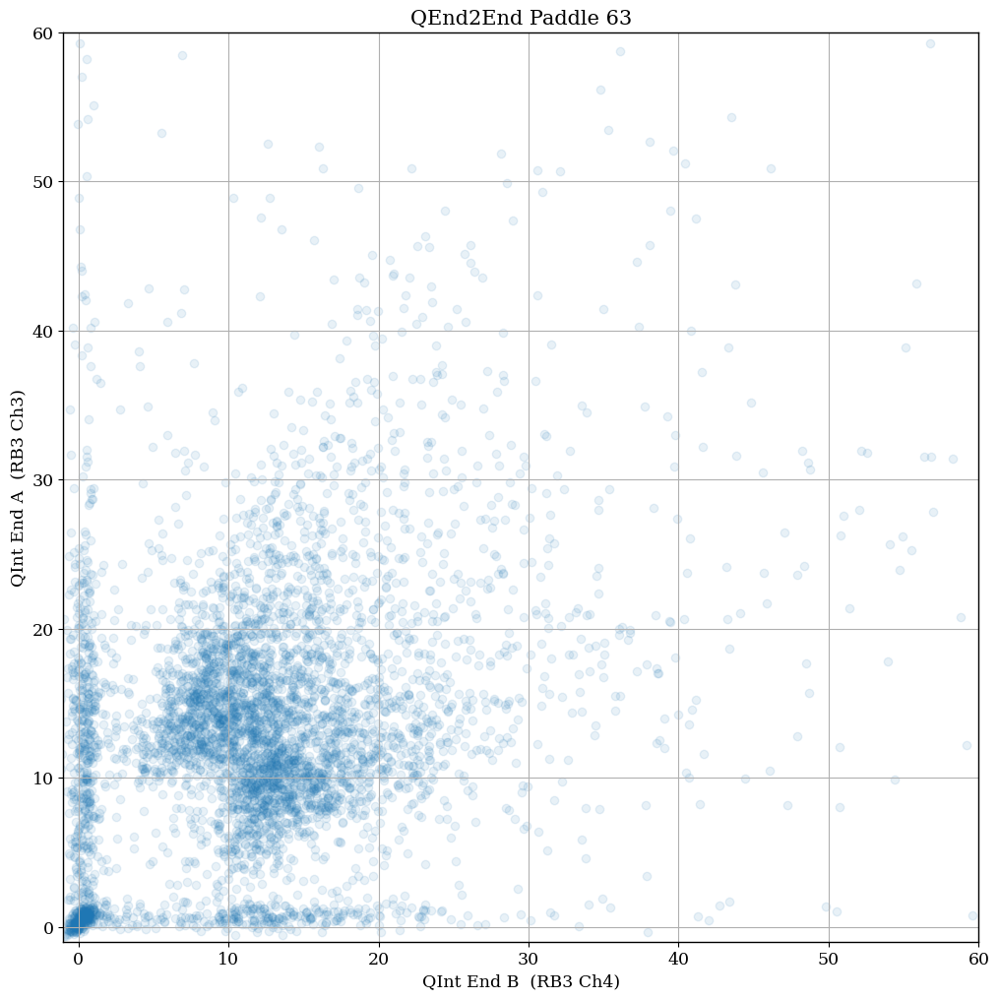

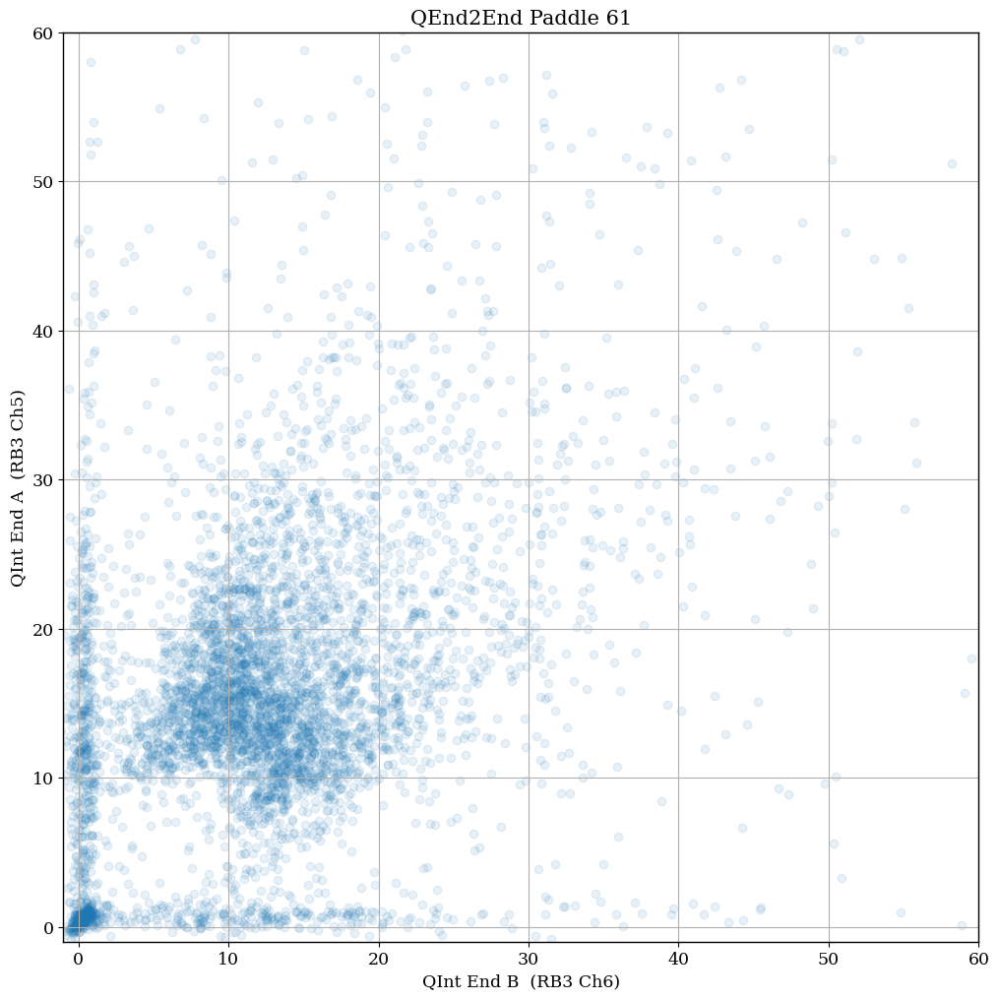

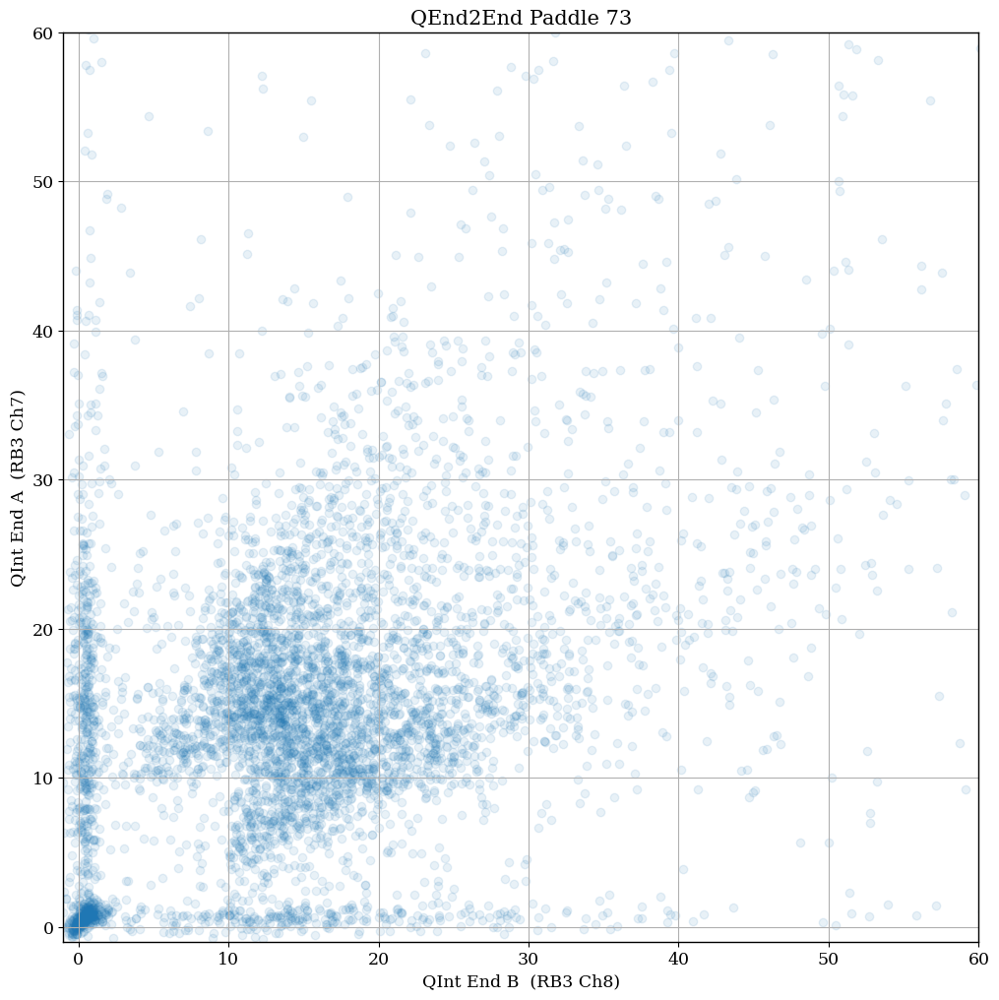

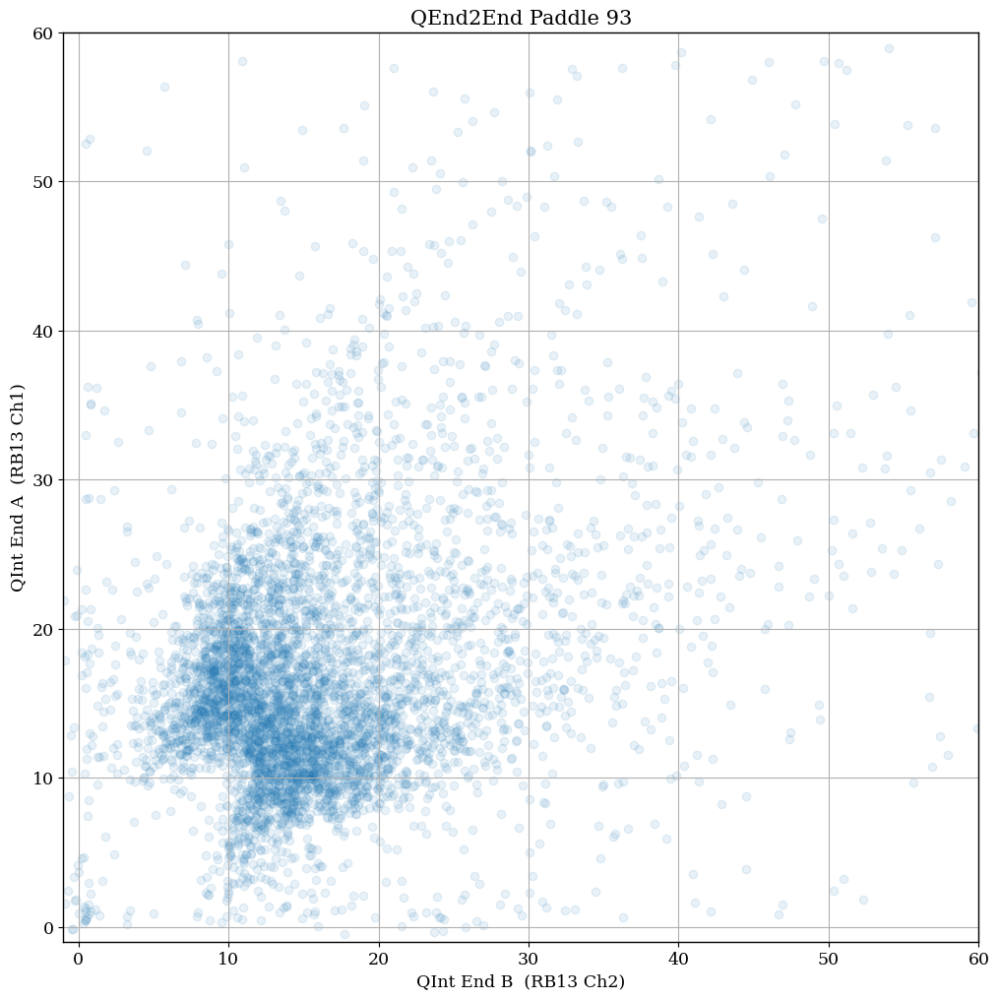

...

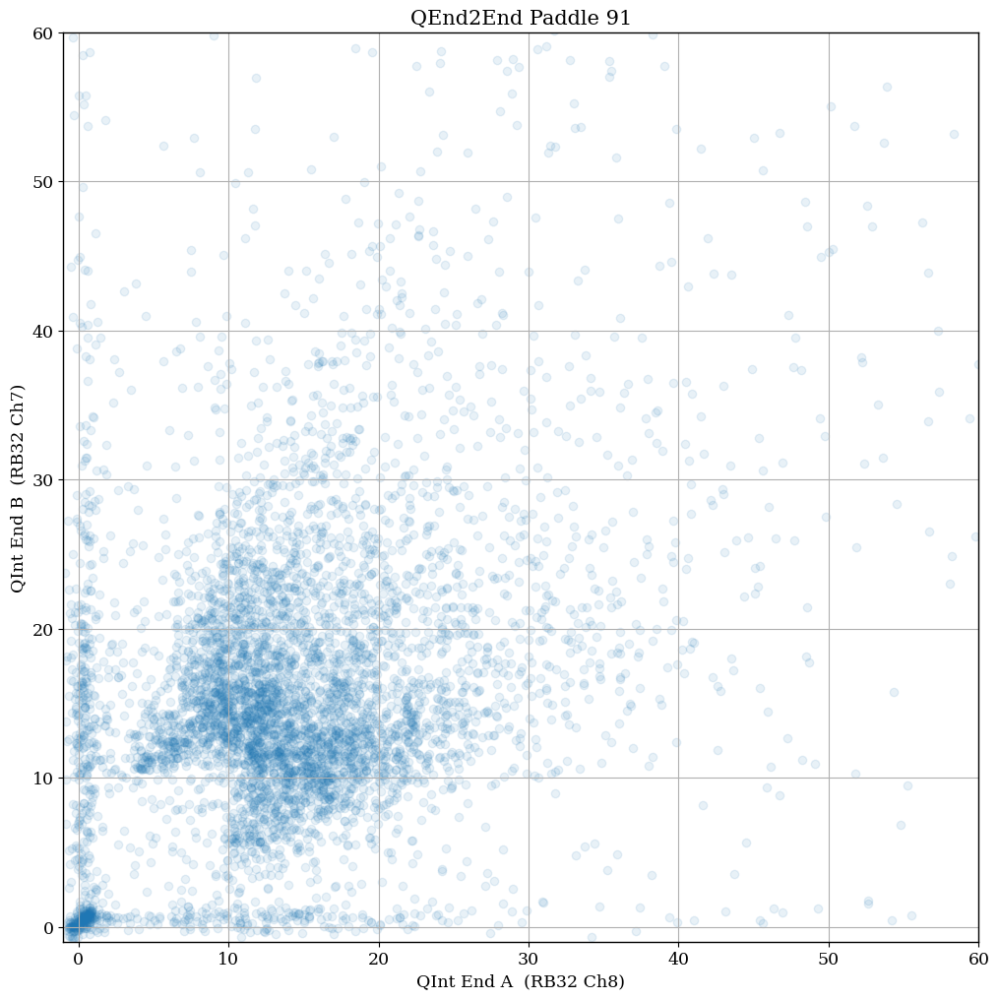

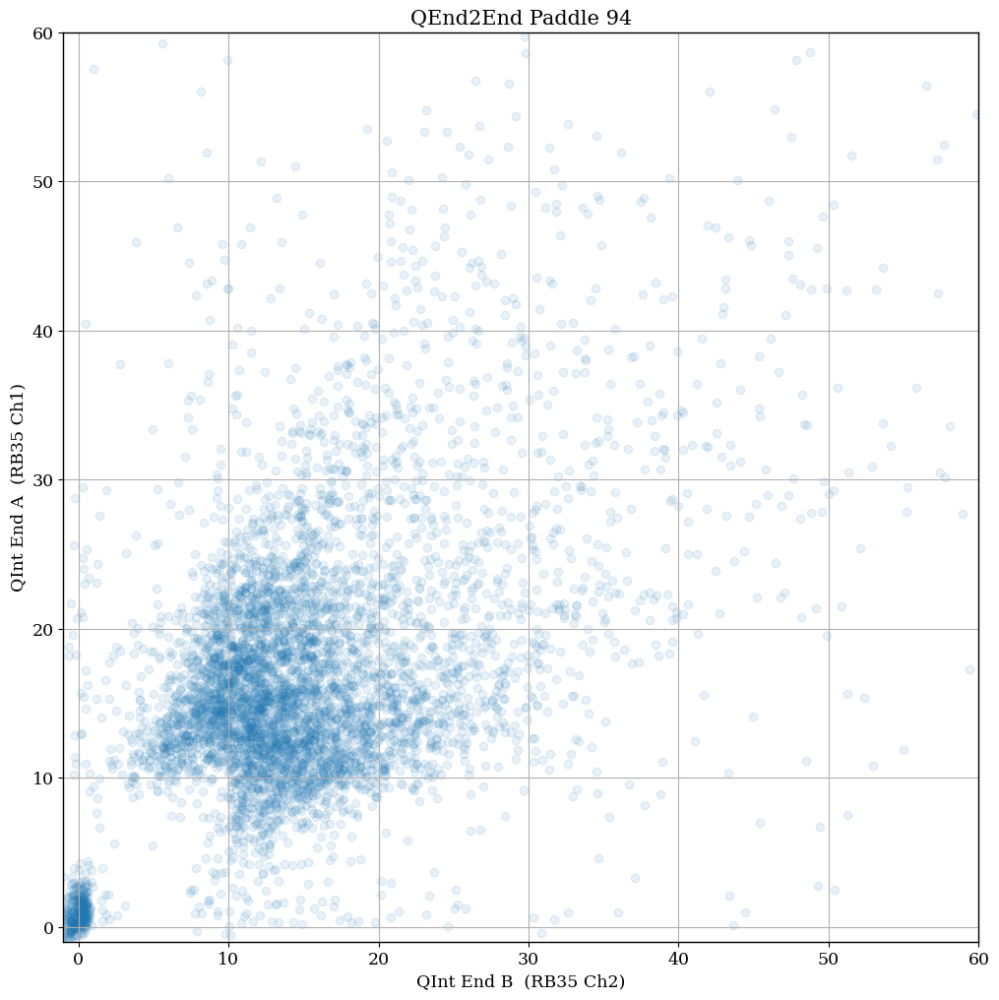

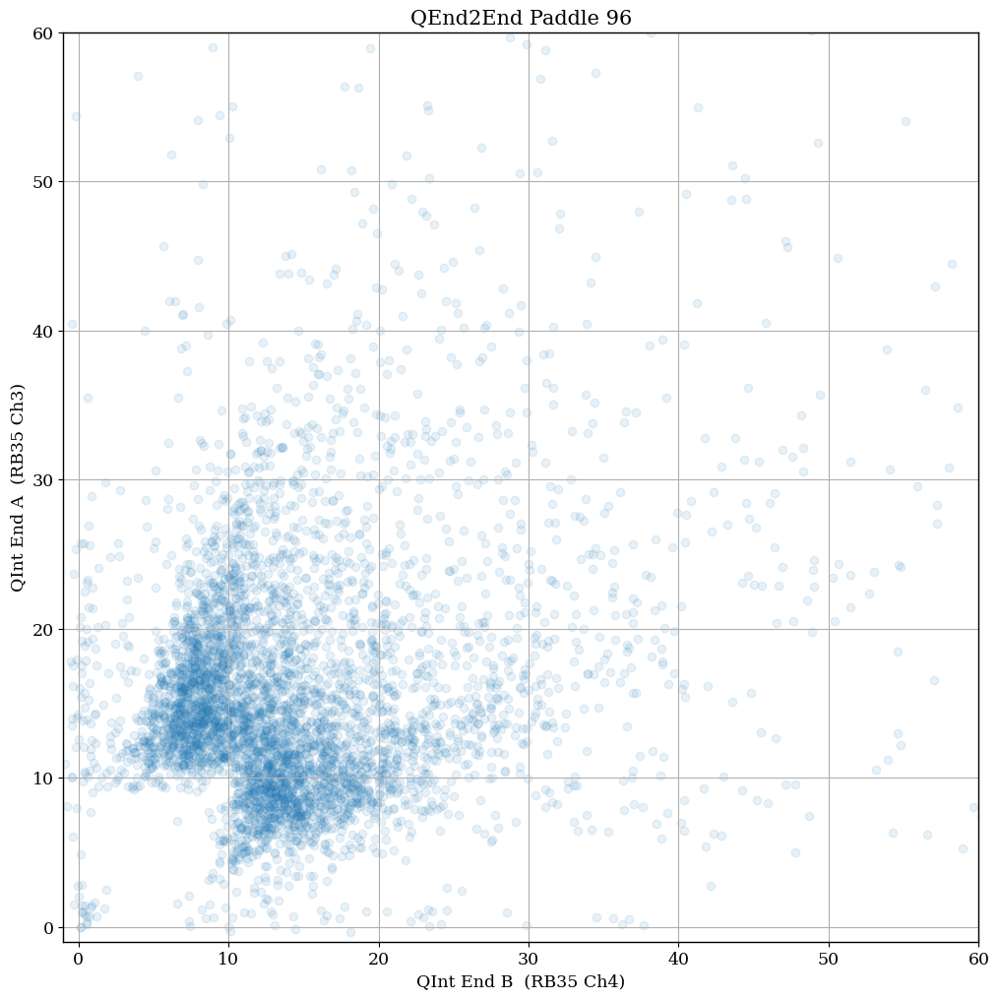

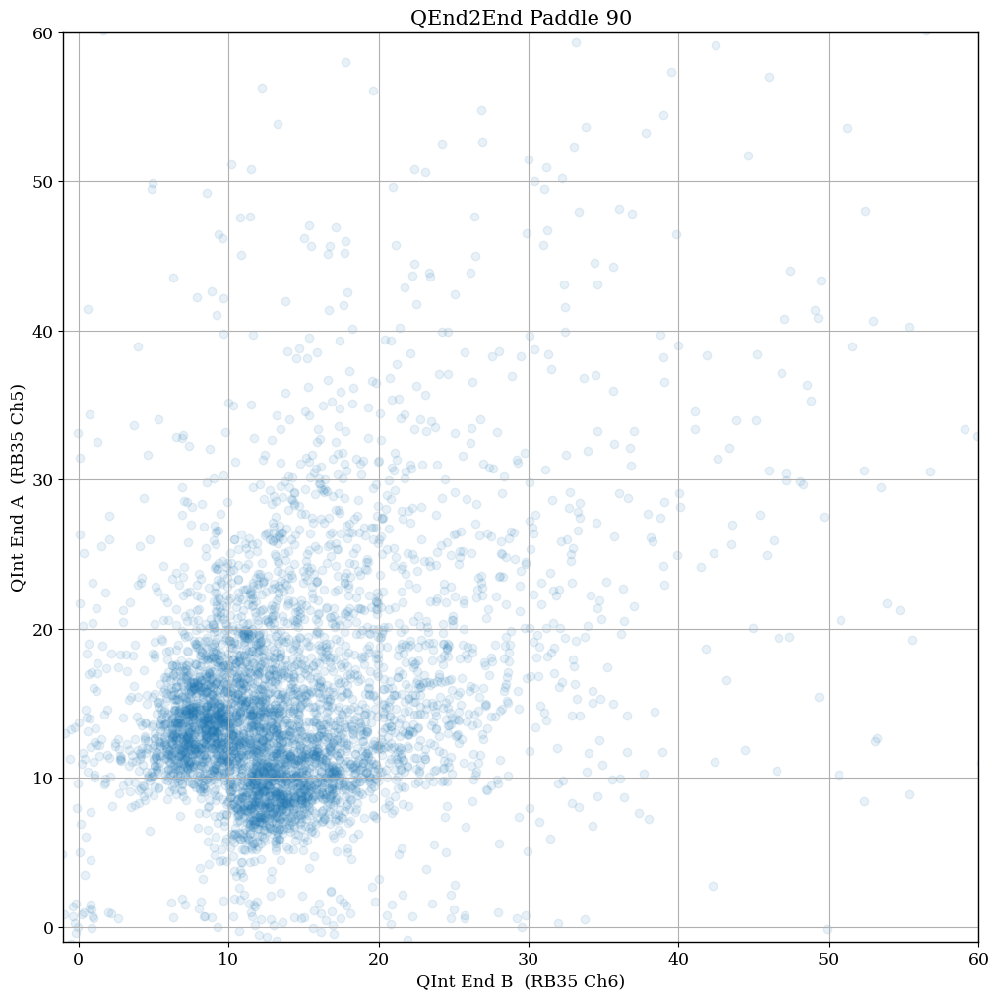

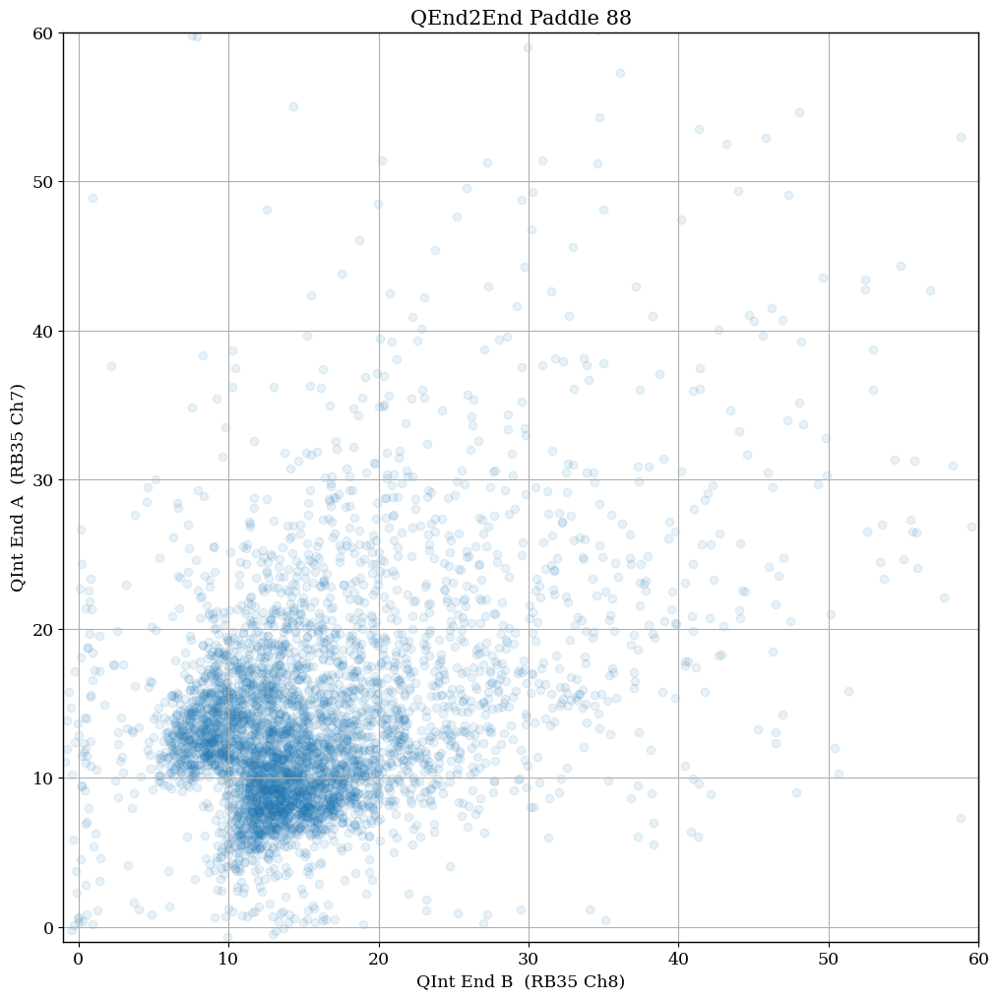

In [15]:
for rb in keys:

    for ch in range(4):
        
        padd1 = 2*(ch+1)
        padd2 = 2*(ch+1)-1
        
        paddle_num = paddmap[str(rb)][str(padd1)]%1000

        # umbrella paddle requirement
        if (paddle_num > 60 and paddle_num < 109):
            
            if (paddmap[str(rb)][str(padd1)] > 2000):
                padd1_AB = "B"
                padd2_AB = "A"
                
                #if (paddmap[str(rb)][str(padd2)] > 2000):
                #    print("MISMATCH??")
            
            else:
                padd1_AB = "A"
                padd2_AB = "B"
                
                #if (paddmap[str(rb)][str(padd2)]  2000):
                #    print("MISMATCH??")
            
            fig,ax = plt.subplots(figsize=(12,12))

            padd2Q = np.array(Q_dict[rb][2*ch])
            padd1Q = np.array(Q_dict[rb][2*ch+1])
            plt.scatter(padd1Q,padd2Q,alpha=0.1)
            plt.ylim(-1,60)
            plt.xlim(-1,60)
            plt.xlabel("QInt End " + padd1_AB + "  (RB" + str(rb) + " Ch" + str(2*(ch+1)) + ")")
            plt.ylabel("QInt End " + padd2_AB + "  (RB" + str(rb) + " Ch" + str(2*(ch+1)-1) + ")")
            plt.grid()
            plt.title("QEnd2End Paddle " + str(paddle_num))
            plt.show()